## **Loca Como Tu Madre**
### Análise das operações Julho 2022- Maio 20223

In [1]:
# jupyter nbconvert --to html --no-input lctm_v03.ipynb

In [2]:
from IPython import display

import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
# import seaborn as sns; sns.set()
import datetime
import nbformat
import plotly.express as px
from plotly.offline import download_plotlyjs, init_notebook_mode, plot, iplot
init_notebook_mode (connected = True )
import plotly.graph_objs as go
import plotly.offline as py
from matplotlib.backends.backend_pdf import PdfPages
from fpdf import FPDF
pd.options.display.max_columns = None
pd.options.display.max_rows = None
import locale
import plotly.io as pio
from datetime import date
import calendar

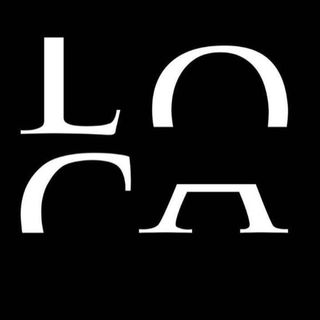

In [3]:
display.Image("/home/claudio/@LCTM/lctm001/lctm_logo.jpg",width=215)

In [4]:
# setar locale para português para que os dias da semana retornem em portugês no código abaixo.
locale.setlocale(locale.LC_ALL, 'pt_BR.utf-8')

# Importing each csv file and then joinning then, 
# as the files for other months are send by the client we can insert each one at the end of this code

df1 = pd.read_csv(r'/home/claudio/@LCTM/lctm001/2022_07.csv', encoding="ISO-8859-1", sep = ';')
df2 = pd.read_csv(r'/home/claudio/@LCTM/lctm001/2022_08.csv', encoding="ISO-8859-1", sep = ';')
df3 = pd.read_csv(r'/home/claudio/@LCTM/lctm001/2022_09.csv', encoding="ISO-8859-1", sep = ';')
df4 = pd.read_csv(r'/home/claudio/@LCTM/lctm001/2022_10.csv', encoding="ISO-8859-1", sep = ';')
df5 = pd.read_csv(r'/home/claudio/@LCTM/lctm001/2022_11.csv', encoding="ISO-8859-1", sep = ';')
df6 = pd.read_csv(r'/home/claudio/@LCTM/lctm001/2022_12.csv', encoding="ISO-8859-1", sep = ';')
df7 = pd.read_csv(r'/home/claudio/@LCTM/lctm001/2023_01.csv', encoding="ISO-8859-1", sep = ';')
transactions = pd.concat([df1, df2, df3, df4, df5, df6, df7], ignore_index=True)

In [5]:
## DROPPING THE ROWS THAT ALL COLUMN VALUES ARE NULL
#  https://www.youtube.com/watch?v=uDr67HBIPz8&t=818s

# dropping columns that not will be used in the analysis
transactions = transactions.dropna(how='all')
del transactions['Vr. Desconto']
del transactions['Valor Venda']
del transactions['Tx Serviço']
del transactions["Caixa"]
del transactions['Operador']
del transactions['Data Cancelamento']
del transactions['Operador Cancelamento']
del transactions['Operador Desconto']
del transactions['Operador Desc Repique']
del transactions['NRC']
del transactions['Comandas']
del transactions['Série NFCE']
del transactions['Série NFE']
del transactions['Integração']
del transactions['Observação']
del transactions['CO_CLIENTE']
del transactions['Atendente']
del transactions['IC_REVENDA']

# renomeei a coluna 'Tipo Operação' para 'venda'.
transactions.rename(columns = {'Tipo Operação':'venda'}, inplace = True)

# Pandas Drop Rows Based on Column Value
# https://sparkbyexamples.com/pandas/pandas-delete-rows-based-on-column-value/
transactions.drop(transactions[transactions['venda'] == 'CO_VENDA'].index, inplace = True)

# renomeei a coluna 'Cod Venda' para 'prim_col'.
transactions.rename(columns = {'Cod Venda':'prim_col'}, inplace = True)

# If 'prim_col' value is not empty, set the value of column 'venda' to the value of column 'prim_col', else value of column 'venda' stays the same
transactions['venda'] = transactions.apply(lambda row: row['prim_col'] if row['venda'] == 'LOCA' else row['venda'], axis=1)

# If 'prim_col' value is not empty, set the value of column 'venda' to the value of column 'prim_col', else value of column 'venda' stays the same
transactions['venda'] = transactions.apply(lambda row: row['prim_col'] if row['venda'] == 'Balcao' else row['venda'], axis=1)

# Vamos analisar cada parte dessa linha:
#transactions['venda']: Estamos nos referindo à coluna 'venda' do DataFrame transactions.
# Essa coluna será atualizada com base no resultado da operação que será realizada a seguir.
#transactions.apply(...): O método apply() é usado para aplicar uma função a todas as linhas 
# (ou colunas) de um DataFrame. Neste caso, a função está sendo aplicada às linhas, conforme
# especificado pelo argumento axis=1.
#lambda row: ...: Estamos usando uma função lambda, que é uma função anônima e de uso único.
# Essa função aceita um argumento chamado row, que representa uma linha do DataFrame transactions.
#row['prim_col'] if row['venda'] == 'LOCA' else row['venda']: Esta é a lógica da função lambda.
# Estamos usando uma expressão condicional para verificar se o valor da coluna 'venda' na
# linha atual (row['venda']) é igual a 'LOCA'. Se for verdade, o valor da coluna 'prim_col'
# na mesma linha (row['prim_col']) será usado como resultado. Caso contrário, o próprio valor da coluna 'venda' será mantido.

# Função para verificar se o valor é uma string e contém apenas letras, testando se o código da celula anterior funcionou
def is_string_with_letters(value):
    return isinstance(value, str) and value.isalpha()

# Aplicando o filtro para manter apenas as linhas onde o valor da coluna 'venda' é uma string e contém apenas letras
filtered_transactions = transactions[transactions['venda'].apply(is_string_with_letters)]

# Função para verificar se o valor é uma data
def is_date(value):
    try:
        pd.to_datetime(value)
        return True
    except ValueError:
        return False

# Função para aplicar à coluna
def copy_date_or_set_nd(value):
    return value if is_date(value) else 'nd'

# Criar a nova coluna 'data_venda' aplicando a função copy_date_or_set_nd
transactions['data_venda'] = transactions['Data Venda'].apply(copy_date_or_set_nd)

# Criar a nova coluna 'data_recebimento' aplicando a função copy_date_or_set_nd
transactions['data_recebimento'] = transactions['Data Recebimento'].apply(copy_date_or_set_nd)

# Convert the "venda" variable from object type to integer type
transactions['venda'] = np.int64(transactions['venda'])

# Agrupar o DataFrame pela coluna 'venda'
grouped = transactions.groupby('venda')

# Para cada grupo, encontrar a primeira data na coluna "data_venda" e atualizar todas as linhas do grupo
for group_name, group_df in grouped:
    first_date = group_df['data_venda'].apply(is_date).idxmax()
    matching_date = transactions.loc[first_date, 'data_venda']
    
    transactions.loc[transactions['venda'] == group_name, 'data_venda'] = matching_date

# Agrupar o DataFrame pela coluna 'venda'
grouped = transactions.groupby('venda')

# Para cada grupo, encontrar a primeira data na coluna "data_recebimento" e atualizar todas as linhas do grupo
for group_name, group_df in grouped:
    first_date_recebimento = group_df['data_recebimento'].apply(is_date).idxmax()
    matching_date = transactions.loc[first_date_recebimento, 'data_recebimento']
    
    transactions.loc[transactions['venda'] == group_name, 'data_recebimento'] = matching_date


# Agrupando as linhas com base na coluna 'venda'
grouped_transactions = transactions.groupby('venda')

# Preenchendo os valores nulos na coluna 'Vendedor' com o primeiro valor não nulo encontrado dentro do grupo
transactions['Vendedor'] = grouped_transactions['Vendedor'].transform(lambda x: x.ffill().bfill())

# Deletando a primeira coluna, pois não será mais utilizada
del transactions['prim_col']

# Deletando linhas com valor NaN na coluna 'NFe'
transactions = transactions.dropna(subset=['NFe'])

# Renomeando várias colunas
transactions = transactions.rename(columns={
    'NFe': 'cod_produto',
    'NFCe': 'produto',
    'Data Venda': 'quantidade',
    'Data Recebimento' : 'valor_unit',
    'Nome Cliente': 'total_item',
    'Valor Recebido': 'data_lanc',
    'Operação': 'atendente',
    'Vendedor': 'vendedor'
})

# Aplicando o filtro para marcar as linhas onde o valor da coluna 'quantidade' é igual a uma data
filtered_transactions_quantidade= transactions[transactions['quantidade'].apply(is_date)]
# depois quero deletar essa linha filtrada
transactions.drop(filtered_transactions_quantidade.index, inplace=True)

# Fazendo algumas conversôes

# Convert coluna "quantidade" variable from object type to integer type
transactions['quantidade'] = np.int64(transactions['quantidade'])

# change the decimal separator of the the variable "valor_unit" from "," to "."
# https://cursos.alura.com.br/forum/topico-transformar-pontos-por-virgulas-dentro-de-um-dataframe-121090
transactions['valor_unit'] = transactions['valor_unit'].str.replace(",",".")
transactions['valor_unit'] = transactions['valor_unit'].astype(float)
# change the decimal separator of the the variable "valor_unit" from "," to "."
# https://cursos.alura.com.br/forum/topico-transformar-pontos-por-virgulas-dentro-de-um-dataframe-121090
transactions['total_item'] = transactions['total_item'].str.replace(",",".")
transactions['total_item'] = transactions['total_item'].astype(float)

#converter data_lanc to datetime format
transactions['data_lanc'] = pd.to_datetime(transactions['data_lanc'], format='%d/%m/%Y %H:%M:%S')

# converter data_venda to datetime format
transactions['data_venda'] = pd.to_datetime(transactions['data_venda'], format='%d/%m/%Y %H:%M:%S')

# converter data_recebimento to datetime format
transactions['data_recebimento'] = pd.to_datetime(transactions['data_recebimento'], format='%d/%m/%Y %H:%M:%S')

# Criação de colunas para facilitar a análise

# Creating a horario column that is a copy of data_hora and coverting it to datetime and extracting only the day;
transactions['data'] = (transactions['data_lanc'])
transactions['data'] = transactions['data'].dt.date

# insert a column name 'mes' 
transactions['mes'] = transactions.data_lanc.dt.month

# add hora and minuto column; using class attributes .hour and .minute

transactions['hora'] = transactions.data_lanc.dt.hour
transactions['minuto'] = transactions.data_lanc.dt.minute

# add hora_minute column and formating as time based on data_lan column

transactions['hora_minuto']=pd.to_datetime(transactions['data_lanc'])
transactions['hora_minuto'] = transactions['hora_minuto'].dt.time

# ### Extracting only the Date from 'data_lanc' column as Datetime format
transactions['data_normal'] = transactions['data_lanc'].dt.normalize()

In [6]:
# Definindo a função time_of_day
def time_of_day(hora):
    """
    Determina se a  compra foi feita pela manhã, tarde ou noite.
    """
    
    if hora < 12:
        
        return 'manhã'
    
    elif hora < 17:
        
        return 'tarde'
    
    else:
        
        return 'noite'
    
transactions['periodo_do_dia'] = transactions.hora.apply(time_of_day)

In [7]:
# Add a day of week variable and a second classifier of weekday or weekend
transactions['dia_da_semana'] = [calendar.day_name[i.weekday()] for i in transactions['data_lanc']]

# Add a tipo_de_dia variable (FS= final de semana or DU=  dia útil)
transactions['tipo_de_dia'] = ['FS' if (i == 'domingo') | (i == 'sábado') else 'DU' for i in 
                                                                            transactions['dia_da_semana']]
# Verificando se o valor "total_item" é igual a: "quantidade" * "valor_unit"

transactions["total_item_verif"] = transactions['quantidade']* transactions['valor_unit']

# Continuando o item anterior
# https://www.dataquest.io/blog/tutorial-add-column-pandas-dataframe-based-on-if-else-condition/

transactions['confirm'] = np.where(transactions['total_item'] > transactions['total_item_verif'], True, False)

#### Creating a Column diference
transactions['diference']=(transactions['total_item'])-(transactions['total_item_verif'])

# continuando o item anterior
resumo = transactions.loc[transactions["confirm"] == True, ["total_item", "total_item_verif", 'diference']].sum()

###############################################################################################################################
#Não encontramos nenhuma divergência entre os valores ao efetuarmos a multiplicação do valor de venda do item por sua quantidade, 
# e compararmos com o valor expresso na coluna "total_item", o valor dessa diferença é zero.

# vamos deletar as colunas utilizadas para fazer o cálculo anterior
transactions.drop('total_item_verif', axis=1, inplace= True)
transactions.drop('confirm', axis=1, inplace= True)
transactions.drop('diference', axis=1, inplace= True)

In [8]:
## EXPLORAÇÃO DOS DADOS

## Introdução

Foi realizada a análise de dados do estabelecimento, o que envolve coletar e interpretar informações do negócio, como número de clientes, pratos mais vendidos, tempo de atendimento, entre outros. Esse processo ajuda a entender melhor o funcionamento do restaurante, identificar áreas de melhoria e tomar decisões informadas para otimizar lucros e eficiência.

In [9]:
faturamento = pd.Series(transactions['total_item'].sum())

In [10]:
# define a function to format currency values
def format_currency(value):
    return locale.currency(value, grouping=True)

### Observações preliminares

In [11]:
### aturamento = float(faturamento)
### faturamento_formatado = format_currency(faturamento)
### print('O faturamento total do periodo foi de: \n',faturamento_formatado)###


Alguns itens chamaram a atenção:

Sobre a categoria couvert artístico, seria interessante obter informações sobre os artistas que se apresentaram nesses horários, pois poderíamos investigar quais deles atraem um público maior e que permanece mais tempo no estabelecimento, gerando um faturamento maior ao estabelecimento.

Ocorreram alguns eventos no estabelecimento, foram identificados 7 registros. No entanto, como não conseguimos determinar quais itens foram vendidos nessas ocasiões, optamos por excluí-los da análise. Considerando que o escopo do trabalho é analisar os produtos vendidos, horário e dia, bem como a sua quantidade, fica inviável realizar um estudo sem essas informações.

Os dados também apresentaram dois tipos de registros que não estão especificadas: "item extra" (73 registros) e "porção extra" (36 registros). Como pode ser observado na tabela abaixo, as vendas desses itens não são relevantes para o resultado do estabelecimento, portanto,  eles também serão retirados da análise.

In [12]:
new_df = pd.DataFrame({
    'produto': transactions['produto'],
    'quantidade': transactions['quantidade'],
    'total_item': transactions['total_item']
}).copy()

In [13]:
# create a boolean mask for selecting rows
mask = (new_df['produto'] == 'PORÇAO EXTRA') | (new_df['produto'] == 'ITEM EXTRA') | (new_df['produto'] == 'EVENTO.') | (new_df['produto'] == 'EVENTO') | (new_df['produto'] == 'EVENTO CORPORATIVO')

# select the rows that match the mask
new_df_filtrado = new_df.loc[mask].copy()

In [14]:
new_df_filtrado['produto']= new_df_filtrado['produto'].replace(['EVENTO.', 'EVENTO', 'EVENTO CORPORATIVO'], 'EVENTOS DIVERSOS')

In [15]:
group_new_df= new_df_filtrado.groupby(by='produto').sum('total_item').reset_index()
group_new_df['faturamento produto']= group_new_df['total_item'].apply(lambda x: locale.currency(x, grouping=True)).copy()
group_new_df = group_new_df.drop(columns= ['total_item'])

In [16]:
group_new_df.set_index('produto')

,quantidade,faturamento produto
produto,,
EVENTOS DIVERSOS,7,"R$ 17.839,10"
ITEM EXTRA,73,"R$ 503,70"
PORÇAO EXTRA,36,"R$ 360,00"


In [17]:
# dropping the rows as explain above.

# Pandas Drop Rows Based on Column Value
# https://sparkbyexamples.com/pandas/pandas-delete-rows-based-on-column-value/

array= ['EVENTO.', 'EVENTO', 'PORÇAO EXTRA', "ITEM EXTRA", 'EVENTO CORPORATIVO' ]
transactions.drop(transactions[transactions.produto.isin(array)].index, inplace = True)

In [18]:
# criando a dataframe transactions_2022, retirando os dados de 2023 do DF transactions
transactions_2022 = transactions[transactions['data_venda'].dt.year != 2023].copy()


In [19]:
# Create the df_categories
df_categorias = pd.read_csv(r'/home/claudio/@LCTM/lctm001/categorias_produtos_loca.CSV', encoding="ISO-8859-1", sep = ';')
df_categorias.rename(columns = {'PRODUTO':'produto', 'CATEGORIA':'categoria'}, inplace = True)
df_categorias = df_categorias.dropna().copy()
df_categorias = df_categorias.reset_index(drop = True)
df_categorias = df_categorias.applymap(lambda s: s.upper() if type(s) == str else s)
df_categorias['categoria'] = df_categorias['categoria'].str.replace('COMIDA', 'COMIDAS', regex = True)
df_categorias['categoria'] = df_categorias['categoria'].str.replace('BNA', 'BEBIDAS NÃO ALCOÓLICAS', regex = True)


In [20]:
# criando o DF grouped_df_2022
grouped_df_2022 = transactions_2022.groupby('produto')[['total_item', 'quantidade']].sum().reset_index().copy()
grouped_df_2022 = grouped_df_2022.sort_values(by = 'total_item', ascending= False).reset_index(drop= True)

In [21]:
# Calculate the total value across all rows
total_value_itens_2022 = grouped_df_2022['total_item'].sum()

# Create a new column that calculates the percentage
grouped_df_2022['percentual_faturamento'] = ((grouped_df_2022['total_item']/ total_value_itens_2022) * 100).round(2)

grouped_df_2022['valor_unit_med'] = (grouped_df_2022['total_item']/grouped_df_2022['quantidade']).round(2)

In [22]:
# adicionar as categorias
df_grouped_2022_categorized = grouped_df_2022.merge(df_categorias)

## Métricas após as exclusões

## Ranking

Abaixo segue uma tabela com o ranking dos produtos mais vendidos

In [23]:
### Gráfico 01c

fig_top_produtos_2022 = go.Figure(data=[go.Table(
        header=dict(values=list(['Produto', 'Quantidade', 'Percentual Faturamento', 'Categoria', 'Valor Unid. médio']),
                font=dict(color='white', size=12), # configurando a cor e tamanho da letra
                fill_color='black',
                align='left'),
    cells=dict(values=[df_grouped_2022_categorized['produto'], df_grouped_2022_categorized['quantidade'], df_grouped_2022_categorized['percentual_faturamento'], df_grouped_2022_categorized['categoria'],
                       df_grouped_2022_categorized['valor_unit_med']],
               font=dict(color='white', size=12),
               fill_color='gray',
               align='left'))
])


fig_top_produtos_2022.update_layout(
    title={
        'text': "Produtos mais vendidos - (Jul 2022 - Dez 2022)",
        'y':0.95,
        'x':0.5,
        'xanchor': 'center',
        'yanchor': 'top'})

py.iplot(fig_top_produtos_2022)

### Ranking 2023

In [24]:
column_names=["produto"]
df_itens_2023 = pd.read_csv(r'/home/claudio/@LCTM/lctm001/vendas_itens_jan_maio_23.CSV', names = column_names, encoding="ISO-8859-1", sep = ';')

In [25]:
# Regular expression pattern that matches a number possibly followed by a decimal point 
# and any number of digits, and then a comma and two zeros
pattern = '(\d+\.?\d*\,\d+)'

In [26]:
# Use str.extractall() to find and extract these matches into a new DataFrame
matches_df = df_itens_2023["produto"].str.extractall(pattern)

# Now, group by index (level 0), and grab the first and last matches.
df_itens_2023['quantidade'] = matches_df.groupby(level=0)[0].first()
df_itens_2023['valor_total'] = matches_df.groupby(level=0)[0].last()

# Replace NaN values with some default value if needed, for example '0,00'
df_itens_2023[['quantidade', 'valor_total']] = df_itens_2023[['quantidade', 'valor_total']].fillna('0,00')

# Now replace the patterns in 'produto' with an empty string, effectively removing them
df_itens_2023['produto'] = df_itens_2023['produto'].str.replace(pattern, '', regex=True)


In [27]:
df_itens_2023[['produto_cod', 'produto_nome']] = df_itens_2023['produto'].str.split(pat = '-', n=1, expand=True)
del df_itens_2023['produto']
del df_itens_2023['produto_cod']
df_itens_2023.rename(columns={'produto_nome': 'produto'}, inplace= True)

In [28]:
df_itens_2023 ['quantidade'] = df_itens_2023 ['quantidade'].str.replace(".","", regex = True)

In [29]:
# Now replace the patterns in 'quantidade' with an empty string, effectively removing them
pattern2 = '(,\d+)'
df_itens_2023['quantidade'] = df_itens_2023['quantidade'].str.replace(pattern2, '', regex=True)

In [30]:
# remove the '.' from the colum quantidade
df_itens_2023 ['valor_total'] = df_itens_2023 ['valor_total'].str.replace(".","", regex = True)

In [31]:
# replace the ',' to '.' in the column valor_total
df_itens_2023 ['valor_total'] = df_itens_2023 ['valor_total'].str.replace(",",".", regex = True)

In [32]:
# convert to integer the colum quantidade
df_itens_2023['quantidade'] = df_itens_2023['quantidade'].astype(int)

In [33]:
# convert to float the column valor_total
df_itens_2023 ['valor_total'] = df_itens_2023 ['valor_total'].astype(float)

In [34]:
# criar a coluna valor unitário
df_itens_2023['valor_unit_med'] = (df_itens_2023['valor_total']/df_itens_2023['quantidade']).round(2)

In [35]:
df_itens_2023 =  df_itens_2023.sort_values(by = 'quantidade', ascending=False)

In [36]:
# Calculate the total value across all rows
total_value_itens_2023 = df_itens_2023['valor_total'].sum()

# Create a new column that calculates the percentage
df_itens_2023['percentage_fatura'] = ((df_itens_2023['valor_total'] / total_value_itens_2023) * 100).round(2)

In [37]:
# Calculate the total value across all rows
total_quantity_itens_2023 = df_itens_2023['quantidade'].sum()

# Create a new column that calculates the percentage
df_itens_2023['percentual'] = ((df_itens_2023['quantidade'] / total_quantity_itens_2023) * 100).round(2)

In [38]:
df_itens_2023['produto'] = df_itens_2023['produto'].str.strip().str.lower()
df_categorias['produto'] = df_categorias['produto'].str.strip().str.lower()

In [39]:
df_categorized_2023 = df_itens_2023.merge(df_categorias, how='left', on='produto')

In [40]:
df_categorized_2023['categoria'] = df_categorized_2023['categoria'].str.strip()

In [41]:
df_categorized_2023['categoria'] = df_categorized_2023['categoria'].fillna('COMIDAS')

In [42]:
df_categorized_2023['categoria'] = df_categorized_2023['categoria'].str.replace('BNA', 'BEBIDAS NÃO ALCOÓLICAS', regex = True)

In [43]:
df_categorized_2023 = df_categorized_2023.sort_values(by = 'percentage_fatura', ascending= False)

In [44]:
### Tabela 01 B

fig_top_produtos_2023 = go.Figure(data=[go.Table(
    header=dict(values=list(['Produto', 'Quantidade', 'Percentual Faturamento', 'Categoria', 'Valor Unid. médio']),
                font=dict(color='white', size=12), # configurando a cor e tamanho da letra
                fill_color='black',
                align='left'),
    cells=dict(values=[df_categorized_2023['produto'], df_categorized_2023['quantidade'], df_categorized_2023['percentage_fatura'], df_categorized_2023['categoria'], df_categorized_2023['valor_unit_med']],
               font=dict(color='white', size=12),
               fill_color='gray',
               align='left'))
])


fig_top_produtos_2023.update_layout(
    title={
        'text': "Produtos mais vendidos - (Janeiro/23 a 06 de Maio/23)",
        'y':0.95,
        'x':0.5,
        'xanchor': 'center',
        'yanchor': 'top'})

py.iplot(fig_top_produtos_2023)

In [45]:
# GRÁFICO Ranking Itens 2023

# Creating a plot to show the TOP itens sold by month (Jan 2023 - 06 Maio 2023)

item_threshold_2023 = 241



colors_todo = ['black',] * len(df_itens_2023)
# Destacar comidas
colors_todo[9] = 'green' 
colors_todo[15] =  'green' 
colors_todo[20] = 'green'
colors_todo[22] = 'green'
colors_todo[26] = 'green'
colors_todo[27] = 'green'
colors_todo[28] = 'green'


trace_2023 = go.Bar(
    x = df_itens_2023['produto'],
    y = df_itens_2023['quantidade'][(df_itens_2023['quantidade']) > item_threshold_2023],
            #x=item_frequencies_2023[item_frequencies_2023 > item_threshold_2023].index,
            # y=item_frequencies_2023[item_frequencies_2023 > item_threshold_2023].values,
         text=df_itens_2023['quantidade'],
            visible=True,
            marker_color=colors_todo,
            name='Todo periodo'
    )



data_2023 = [trace_2023]


layout_2023 = dict(title='Vendas por item - Jan 2023 - 06 Maio 2023 <br><sup></sup>', showlegend=False)

# to change the background color

layout_2023.update(
    plot_bgcolor='lightgray', 
    xaxis =dict(mirror=True, ticks='outside', showline=True, linecolor='black', gridcolor='lightgray'),
    yaxis =dict(visible= False, mirror=True, ticks='outside', showline=True, linecolor='black', gridcolor='lightcyan')
)
fig_Ranking_2023 = dict(data=data_2023, layout=layout_2023)
py.iplot(fig_Ranking_2023)

## Logo abaixo observamos algumas métricas importantes.

In [46]:
# GRAFICO 02
# Creating an frequencie line

Após estas observações iniciais, identificamos que os principais produtos do estabelecimento são os couverts artisticos seguidos pelas cervejas e chopps, e o Bolinho Acostelado e o Loca Burguer são o primeiros entre as comidas. Dado o amplo leque de itens disponíveis (283), há uma grande variedade entre eles. Notamos que alguns produtos alcançam vendas na casa dos milhares, enquanto outros têm vendas unitárias. A quantidade média de itens vendidos por pedido também é elevada (9), sugerindo que, em geral, as mesas são ocupadas por duas ou mais pessoas. No entanto, durante o período da madrugada, observamos uma média de apenas 3 itens por pedido, indicando a tendência de menores vendas nesse período.

 <h2> Quantidade de itens vendidos por dia ao longo do período analisado</h2>

In [47]:
# Sales trend by date
# https://www.youtube.com/watch?v=Xjm7fOw6gjY
# use reset index for transforming the data in a variable not a index

grouped_by_date_2022 = pd.DataFrame(transactions_2022.groupby(by=['data','dia_da_semana'])['total_item'].sum().reset_index())


In [48]:
vendas = go.Figure()

vendas.add_trace(go.Scatter(
    x=grouped_by_date_2022['data'],
    y=grouped_by_date_2022['total_item'],
    mode='lines',
    text= grouped_by_date_2022['total_item'].apply(lambda x: locale.currency(x, grouping=True)),
    hoverinfo='text',  # Specifies that custom hover text is provided
    hovertext=grouped_by_date_2022['dia_da_semana'],  # Adds day of the week to the hover text
    name='lines',
    hovertemplate = '%{x} - %{text} - %{hovertext}<extra></extra>',  # Customizing hover text with a hovertemplate
    line=dict(color='black')
))

vendas.update_layout(
    title='Faturamento por dia - Jul/22 a Dez/22<br />',
    plot_bgcolor='lightgray',
    xaxis=dict(
        mirror=True,
        ticks='outside',
        showline=True,
        linecolor='black',
        gridcolor='white',
        title='Data'
    ),
    yaxis=dict(
        mirror=True,
        ticks='outside',
        showline=True,
        linecolor='black',
        gridcolor='white',
        title='Faturamento'
    )
)

vendas.show()


<p>Em nossa análise, notamos que, durante os primeiros meses de funcionamento do estabelecimento, não era apenas o sábado que se destacava como um dia de faturamento elevado. As sextas-feiras também apresentavam números expressivos, com uma média de vendas apenas um pouco abaixo dos sábados. Inclusive, houve ocasiões em que a performance das sextas-feiras superou a dos sábados, tornando-se o dia mais lucrativo da semana. 
Entretanto, conforme o ano avançou, constatamos uma diminuição significativa na força das vendas realizadas nas sextas-feiras. Este fenômeno contrasta com a performance dos sábados, que manteve sua robustez e, consequentemente, se tornou o dia de destaque no que se refere ao faturamento.

Esta tendência pode indicar uma mudança nos hábitos dos clientes ou uma eficácia variável das estratégias de venda implementadas nos diferentes dias da semana. A investigação desses fatores pode ser útil para desenvolver táticas mais efetivas, com o objetivo de recuperar a força das vendas das sextas-feiras e otimizar ainda mais o desempenho dos sábados.</p>

In [49]:
# criamos a variável/coluna 'mes_ano' no dataframe transactions
transactions['mes_ano'] = transactions['data_venda'].dt.strftime('%Y-%m')
# criamos o daaframe fatura_grouped_by_month, utilizando o parametro .copy

fatura_grouped_by_month = transactions.groupby(['mes_ano']).agg({"total_item":sum,'quantidade':sum}).reset_index().copy()

#This code snippet groups the transactions DataFrame by the 'month' column and then aggregates the 'quantidade' field using the sum #function. Let's break it down line by line:

#grouped_by_month = transactions.groupby('month'): This line of code uses the groupby method of the pandas DataFrame to group the #rows of transactions based on the unique values in the 'month' column. This creates a GroupBy object, which is a special pandas #object that can be used for aggregation and transformation tasks on the grouped data.

#grouped_by_month.agg({'quantidade': 'sum'}): This line of code uses the agg method of the GroupBy object, which allows you to #apply aggregation functions on one or more columns of the grouped data. The agg method takes a dictionary as input, where the keys #are the column names to be aggregated, and the values are the aggregation functions to be applied. In this case, the dictionary
#{'quantidade': 'sum'} tells pandas to aggregate the 'quantidade' column using the 'sum' function. This will compute the sum of the #'quantidade' values for each group of rows that share the same value in the 'month' column.

#As a result, the code snippet creates a new DataFrame, grouped_by_month, which contains the sum of the 'quantidade' field for each #unique value in the 'month' column.
fatura_grouped_by_month['faturamento_mes']= fatura_grouped_by_month['total_item']#.apply(lambda x: locale.currency(x, grouping=True)).copy()

# chatgpt sugested code 
# https://stackabuse.com/format-number-as-currency-string-in-python/
# retirando o mês de janeiro do Dataframe 2022
filtro_jan_2023 = fatura_grouped_by_month['mes_ano'] != '2023-01'
fatura_grouped_by_month_2022 = fatura_grouped_by_month[filtro_jan_2023]

In [50]:
## Faturamento de Jan a Abril 2023
transactions_2023 = pd.read_csv(r'/home/claudio/@LCTM/lctm001/venda_2023_Jan_Maio.csv', encoding="ISO-8859-1", sep = ';' )
del transactions_2023[' Vr. Desconto ']
del transactions_2023[' Valor Venda ']
del transactions_2023[' Tx Serviço ']
del transactions_2023["Caixa"]
del transactions_2023['Cod Venda']
del transactions_2023['Operação']
del transactions_2023['Operador']
del transactions_2023['NFe']
del transactions_2023['NFCe']
del transactions_2023['Vendedor']
del transactions_2023['Data Cancelamento']
del transactions_2023['Operador Cancelamento']
del transactions_2023['Operador Desconto']
del transactions_2023['Operador Desc Repique']
del transactions_2023['NRC']
del transactions_2023['Comandas']
del transactions_2023['Série NFCE']
del transactions_2023['Série NFE']
del transactions_2023['Integração']
del transactions_2023['Observação']
del transactions_2023['CO_CLIENTE']
del transactions_2023['Atendente']
del transactions_2023['IC_REVENDA']
del transactions_2023 ['Nome Cliente']
del transactions_2023['Tipo Operação']

# convert a float column to string
transactions_2023['Data Venda'] = transactions_2023['Data Venda'].astype(str)

# I want to extract from this column, transactions_2023['Data Venda'] , the date from a string with this format: 	06/05/2023 23:36,
# but I don't want to convert the column to datetime format as some os the rows only have the date value and no hour and minute.
transactions_2023['d_venda'] = transactions_2023['Data Venda'].apply(lambda x: x.split(' ')[0])

# I want to create a column hour using the hour minute of the original string, in fact I want a column time with both hour and minute
transactions_2023['t_venda'] = transactions_2023['Data Venda'].apply(
    lambda x: x.split(' ')[1] if len(x.split(' ')) > 1 else None)

# convert a float column to string
transactions_2023['Data Recebimento'] = transactions_2023['Data Recebimento'].astype(str)


# I want to extract from this column, transactions_2023['Data Venda'] , the date from a string with this format: 	06/05/2023 23:36,
# but I don't want to convert the column to datetime format as some os the rows only have the date value and no hour and minute.
transactions_2023['d_recebi'] = transactions_2023['Data Recebimento'].apply(lambda x: x.split(' ')[0])

# I want to create a column hour using the hour minute of the original string, in fact I want a column time with both hour and minute
transactions_2023['t_recebi'] = transactions_2023['Data Recebimento'].apply(
    lambda x: x.split(' ')[1] if len(x.split(' ')) > 1 else None)

transactions_2023 = transactions_2023.dropna().copy()
del transactions_2023 ['d_venda']
del transactions_2023['t_venda']
del transactions_2023 ['d_recebi']
del transactions_2023['t_recebi']
# Converter de string para datetime format
transactions_2023['data_venda'] = pd.to_datetime(transactions_2023['Data Venda'], format='%d/%m/%Y %H:%M')

transactions_2023['data_recebi'] = pd.to_datetime(transactions_2023['Data Recebimento'], format='%d/%m/%Y %H:%M')

# criar a coluna mes_ano baseado em data_venda
transactions_2023['mes_ano'] = transactions_2023['data_venda'].dt.strftime('%Y-%m')
del transactions_2023['Data Venda']
del transactions_2023['Data Recebimento']
# renomear a coluna Valor Recibo 
transactions_2023['valor_recebido']= transactions_2023[' Valor Recebido ']
# transformar a coluna valor_recebido,tirar o ponto do milhar e o R$ e substituir a virgula por ponto.
transactions_2023['valor_recebido'] = transactions_2023['valor_recebido'].apply(lambda x: x.replace('.', ''))
transactions_2023['valor_recebido'] = transactions_2023['valor_recebido'].apply(lambda x: x.replace('R$ ', ''))
transactions_2023['valor_recebido'] = transactions_2023['valor_recebido'].str.replace(",",".")
transactions_2023['valor_recebido'] = transactions_2023['valor_recebido'].astype(float)
del transactions_2023[' Valor Recebido ']
# criar a coluna data, só com dia mes e ano, tirar a hora, baseado em data_venda
transactions_2023['data'] = transactions_2023['data_venda'].dt.date
# criar a coluna hora baseado em data_venda
transactions_2023['hora'] = transactions_2023['data_venda'].dt.hour
# Criar a coluna periodo do dia
transactions_2023['periodo_do_dia'] = transactions_2023.hora.apply(time_of_day)
transactions_2023['dia_da_semana'] = [calendar.day_name[i.weekday()] for i in transactions_2023['data_venda']]
# Add a tipo_de_dia variable (FS= final de semana or DU=  dia útil)
transactions_2023['tipo_de_dia'] = ['FS' if (i == 'domingo') | (i == 'sábado') else 'DU' for i in 
                                                                            transactions_2023['dia_da_semana']]
# Criamos o dataframe faturamento por data
grouped_by_date_2023 = pd.DataFrame(transactions_2023.groupby(by=['data','dia_da_semana'])['valor_recebido'].sum().reset_index()).copy()

In [51]:
vendas_2023 = go.Figure()

vendas_2023.add_trace(go.Scatter(
    x=grouped_by_date_2023['data'],
    y=grouped_by_date_2023['valor_recebido'],
    mode='lines',
    text= grouped_by_date_2023['valor_recebido'].apply(lambda x: locale.currency(x, grouping=True)),
    hoverinfo='text',  # Specifies that custom hover text is provided
    hovertext=grouped_by_date_2023['dia_da_semana'],  # Adds day of the week to the hover text
    name='lines',
    hovertemplate = '%{x} - %{text} - %{hovertext}<extra></extra>',  # Customizing hover text with a hovertemplate
    line=dict(color='black')
))

vendas_2023.update_layout(
    title='Faturamento por dia - Jan/23 a 06 de Maio/23<br />',
    plot_bgcolor='lightgray',
    xaxis=dict(
        mirror=True,
        ticks='outside',
        showline=True,
        linecolor='black',
        gridcolor='white',
        title='Data'
    ),
    yaxis=dict(
        mirror=True,
        ticks='outside',
        showline=True,
        linecolor='black',
        gridcolor='white',
        title='Faturamento'
    )
)

vendas_2023.show()


## Evolução do faturamento

In [52]:
# criamos o dataframe fatura_grouped_by_month, utilizando o parametro .copy

fatura_grouped_by_month_2023 = transactions_2023.groupby(['mes_ano']).agg({"valor_recebido":sum}).reset_index().copy()

In [53]:
# Cria a coluna 'faturamento_mes' e formata-la para padrão moeda BR Real
fatura_grouped_by_month_2023['faturamento_mes']= fatura_grouped_by_month_2023['valor_recebido']


In [54]:
# Drop the colum 'valor_recebido'
fatura_grouped_by_month_2023 = fatura_grouped_by_month_2023.drop(['valor_recebido'], axis= 1)

In [55]:
# retirando o mês de maio do Dataframe 2023, por que não temos todos os daados do mês
filtro_maio_2023 = fatura_grouped_by_month_2023['mes_ano'] != '2023-05'
fatura_grouped_by_month_2023 = fatura_grouped_by_month_2023[filtro_maio_2023]

# Faturamento Julho 2022 a Abril 2023 

In [56]:
# fazer o merge dos dois Dataframes
union_df = pd.concat ([fatura_grouped_by_month_2022.drop(['total_item','quantidade'], axis = 1), fatura_grouped_by_month_2023 ], ignore_index=True)

In [57]:
# Gráfico 04B

fig_union_go = go.Figure([go.Bar (x=union_df['mes_ano'], y=union_df['faturamento_mes'],
                                  
            marker_color="black", text= union_df['faturamento_mes'].apply(lambda x: locale.currency(x, grouping=True)),
            
        )])
fig_union_go.add_annotation(x = '2022-08', y = 225000, text = 'R$ 220.000,00 <br /> Break-even point', showarrow= True, arrowhead= 2)

fig_union_go.add_shape(
            type="line",
            x0=union_df['mes_ano'].min(),
            x1=union_df['mes_ano'].max(),
            y0=220000,
            y1=220000,
            line=dict(
                color="Green",
                width=3
            ),
)



# add the R$ symbol and thounsand delimiter
# https://stackoverflow.com/questions/58140143/add-currency-symbol-in-the-y-axis-scale-using-plotly-method-in-python
fig_union_go.update_layout(plot_bgcolor='lightgray', 
                        yaxis_tickprefix = 'R$', yaxis_tickformat = ',.2f', title = 'Faturamento Mensal<br />Jul/22 a Abril/23', 
                        #xaxis = dict(title = ''),
                        yaxis = dict(visible= False, title = 'Faturamento')
                                     )

    
   # xaxis =dict(mirror=True, ticks='outside', showline=True, linecolor='black', gridcolor='lightgray'),
    # yaxis =dict(visible= False, mirror=True, ticks='outside', showline=True, linecolor='black', gridcolor='lightcyan')



fig_union_go.show()

Aqui observamos o problema a ser solucionado, temos que dar sugestões aos gestores, baseadas nos dados, para que eles possam tomar decisões gerencias que façam o faturamento ultrapassar a faixa dos 220 mil reais por mês, o que até o prsente mês não foi conseguido.

## Analisando a venda de itens


Agora iremos analisar mais detalhadamente a distribuição na venda de cada item proporcionalmente as vendas totais

In [58]:
# retirar quaisquer espaços da coluna 'categoria' para que possamos utlizar o mapeamento
df_grouped_2022_categorized['categoria'] = df_grouped_2022_categorized['categoria'].str.strip()

# ordenando por percentual do faturamento em ordem decrescente
df_grouped_2022_categorized = df_grouped_2022_categorized.sort_values(by = 'percentual_faturamento', ascending= False)

# Define a color scheme for each category
color_dict = {"CERVEJAS": 'lightgreen', "ARTISTAS": 'purple', 'COMIDAS': 'gold', 'BEBIDAS NÃO ALCOÓLICAS': 'royalblue', 'DIVERSOS':'brown', 'SOUVENIR' : 'red', 'BEBIDAS': 'darkorange'}

# Map category to color
df_grouped_2022_categorized['color'] = df_grouped_2022_categorized['categoria'].map(color_dict)


In [59]:
# Inserir um gráfico de pizza da df_grouped_2022_categorized
# GRÁFICO 05B

fig_pie_3B = go.Figure(data=[go.Pie(labels=df_grouped_2022_categorized['categoria'], values=df_grouped_2022_categorized['percentual_faturamento'], pull=[0, 0.2, 0, 0, 0, 0,0], 
                                   marker=dict(colors=df_grouped_2022_categorized['color']), textinfo='label+percent')])

fig_pie_3B.layout = dict(title="Percentual do Faturamento por Categoria  <br><sup>(Jul 22 - Dez 22)</sup>", showlegend=True,
  paper_bgcolor='lightgray',  # Set the plot background color
   legend=dict(font=dict(size=14), tracegroupgap=7,  # Set the gap between legend color squares
        bordercolor='black',  # Set the border color around the legend color squares
        borderwidth=1  # Set the border width around the legend color squares
)  # Set the font size in the legend 
)

fig_pie_3B.update_traces(hoverinfo='label+percent', textfont_size=11,
                  )


py.iplot(fig_pie_3B)

In [60]:
# retirar quaisquer espaços da coluna 'categoria' para que possamos utlizar o mapeamento
df_categorized_2023['categoria'] = df_categorized_2023['categoria'].str.strip()

# ordenando por percentual do faturamento em ordem decrescente
df_categorized_2023 = df_categorized_2023.sort_values(by = 'percentage_fatura', ascending= False)

# Define a color scheme for each category
color_dict = {"CERVEJAS": 'lightgreen', "ARTISTAS": 'purple', 'COMIDAS': 'gold', 'BEBIDAS NÃO ALCOÓLICAS': 'royalblue', 'DIVERSOS':'brown', 'SOUVENIR' : 'red', 'BEBIDAS': 'darkorange'}

# Map category to color
df_categorized_2023['color'] = df_categorized_2023['categoria'].map(color_dict)


In [61]:
# Inserir um gráfico de pizza da tabela df_categorized_2023
# GRÁFICO 05

fig_pie_3 = go.Figure(data=[go.Pie(labels=df_categorized_2023['categoria'], values=df_categorized_2023['percentage_fatura'], pull=[0, 0, 0.2, 0, 0, 0,0], 
                                   marker=dict(colors=df_categorized_2023['color']), textinfo='label+percent')])

fig_pie_3.layout = dict(title="Percentual do Faturamento por Categoria  <br><sup>(01 Janeiro 23 - 06 Maio 23)</sup>", showlegend=True,
  paper_bgcolor='lightgray',  # Set the plot background color
   legend=dict(font=dict(size=14), tracegroupgap=7,  # Set the gap between legend color squares
        bordercolor='black',  # Set the border color around the legend color squares
        borderwidth=1  # Set the border width around the legend color squares
)  # Set the font size in the legend 
)

fig_pie_3.update_traces(hoverinfo='label+percent', textfont_size=11,
                  )


py.iplot(fig_pie_3)

In [62]:
df_diversos = (df_categorias.loc[df_categorias['categoria'] == 'DIVERSOS']).set_index('categoria')
diversos_list = df_diversos['produto'].tolist()
print('Os itens que compõe a categoria diversos são:\n',', '.join(str(item) for item in diversos_list))

Os itens que compõe a categoria diversos são:
 embalagem g, embalagem m, meia sete, taxa rolha, loca pink promo


In [63]:
# só para dar espaço

Observamos, que a venda de itens da categoria comida, caiu em termos percentuais, em detrimento das categorias, bebidas, cervejas, e artistas, principalmente, pode-se constatar baseado não só no grafico acima como também nos dados anteriores, que não houve queda na venda da categoria comidas em termos absolutos, o que nos leva a seguinte conslusão, as demais categorias que tiveram uma acrescimo de venda, isso posto, acredito que isso nos dá um clara direção para solucionar o aumento do faturamento. O estabelecimento tem que fazer um esforço para elevar as vendas de aliemtnos na mesma proporção que já conseguiu elevar a vendas das categorias antes mencionadas. 

In [64]:
# Find the frequency of each item purchased and by time of day

item_frequencies_all = transactions.produto.value_counts()
item_frequencies_morning = transactions[transactions.periodo_do_dia == 'manhã'].produto.value_counts()
item_frequencies_afternoon = transactions[transactions.periodo_do_dia == 'tarde'].produto.value_counts()
item_frequencies_evening = transactions[transactions.periodo_do_dia == 'noite'].produto.value_counts()
# GRÁFICO 06

# Creating a plot with the TOP itens sold per period of the day

# Plot the frequency of purchase for each item

# https://community.plotly.com/t/errors-accessing-plotly-api/33271
# ok, so I found a solution to my problem - when I let my program run through, the error message produced is:
#chart_studio.exceptions.PlotlyRequestError: Authentication credentials were not provided.
#I Googled this error and there were suggestions to run plotly in offline mode by replacing:



# Solving the problem of the 'plotly' online library with chart_studio
# https://plotly.com/python/getting-started-with-chart-studio/

##  Now I'm using Plotly Express (px) and Graphics Objects (go) # 13/03/2023

button_layer_1_height = 1.12
button_layer_2_height = 1.065

item_threshold_all = 330
item_threshold_noite = 300
item_threshold_other = 20

# https://plotly.com/python/bar-charts/#basic-bar-charts-with-plotlygraphobjects
# Customizing Individual Bar Colors

# Cores das barras todo dia
colors1 = ['black',] * len(transactions)
colors1[11]= 'crimson' # destacar a venda do hamburguer

# Cores das barras manhã
colors2 = ['black',] * len(transactions)
#colors2[12]= 'crimson' # destacar venda

# Cores das barras tarde
colors3 = ['black',] * len(transactions)
#colors3[11]= 'crimson' # destacar venda

# Cores das barras noite
colors4 = ['black',] * len(transactions)
colors4[11]= 'crimson' # destacar venda de hambuger



# https://plotly.com/python/bar-charts/#basic-bar-charts-with-plotlygraphobjects - customizando as barras
trace_all = go.Bar(
            x=item_frequencies_all[item_frequencies_all > item_threshold_all].index,
            y=item_frequencies_all[item_frequencies_all > item_threshold_all].values,text=item_frequencies_all,
            visible=True,
            marker_color=colors1,
            name='Dia Inteiro'
    )

trace_morning = go.Bar(
            x=item_frequencies_morning[item_frequencies_morning > item_threshold_other].index,
            y=item_frequencies_morning[item_frequencies_morning > item_threshold_other].values,text=item_frequencies_morning,
            visible=False,
            marker_color= colors2,
            name='Manhã'
    )

trace_afternoon = go.Bar(
            x=item_frequencies_afternoon[item_frequencies_afternoon > item_threshold_other].index,
            y=item_frequencies_afternoon[item_frequencies_afternoon > item_threshold_other].values,text=item_frequencies_afternoon,
            visible=False,
            marker_color=colors3,
            name='Tarde'
    )

trace_evening = go.Bar(
            x=item_frequencies_evening[item_frequencies_evening > item_threshold_noite].index,
            y=item_frequencies_evening[item_frequencies_evening > item_threshold_noite].values,text=item_frequencies_evening,
            visible=False,
            marker_color= colors4,
            name='Noite'
    )



data04 = [trace_all, trace_morning, trace_afternoon, trace_evening]

# Inserir um update _layout para colocar um subtitle
# https://stackoverflow.com/questions/58166002/how-to-add-caption-subtitle-using-plotly-method-in-python

updatemenus = list([
    
    dict(
         buttons=list([   
            dict(label = 'Dia inteiro',
                 method = 'update',
                 args = [{'visible': [True, False, False, False]},
                         {'title': 'Os mais vendidos por período (Jul 22 - Jan 23) <br><sup>Dia inteiro - produtos com mais de 330 itens vendidos</sup>'}]),
             
            dict(label = 'Manhã',
                 method = 'update',
                 args = [{'visible': [False, True, False, False]},
                         {'title': 'Os mais vendidos por período (Jul 22 - Jan 23) <br><sup>Manhã - produtos com mais de 20 itens vendidos</sup>'}]),
             
            dict(label = 'Tarde',
                 method = 'update',
                 args = [{'visible': [False, False, True, False]},
                         {'title': 'Os mais vendidos por período (Jul 22 - Jan 23) <br><sup>Tarde - produtos com mais de 20 itens vendidos</sup>'}]),
             
            dict(label = 'Noite',
                 method = 'update',
                 args = [{'visible': [False, False, False, True]},
                         {'title': 'Os mais vendidos por período (Jul 22 - Jan 23) <br><sup>Noite - produtos com mais de 300 itens vendidos</sup>'}])
        ]),
        type='buttons',
        direction = 'right',
        pad = {'r': 10, 't': 10},
        showactive = True,
        x = 0.6, # range from -2 to 3
        xanchor = 'left',
        y = button_layer_1_height,
        yanchor = 'top' )
])
            
layout04 = dict(title="Os mais vendidos por período (Jul 22 - Jan 23) <br><sup>Dia inteiro - produtos com mais de 330 itens vendidos</sup>", showlegend=False,
              updatemenus=updatemenus)

# to change the background color

# the Y axis is not show
# https://www.tutorialspoint.com/how-to-hide-the-y-axis-tick-labels-on-a-chart-in-python-plotly
layout04.update(
    plot_bgcolor='lightgray', 
    xaxis =dict(mirror=True, ticks='outside', showline=True, linecolor='black', gridcolor='lightgray'),
    yaxis =dict(mirror=True, ticks='outside', visible= False, showline=True, linecolor='black', gridcolor='lightgray')
)

## Os itens mais vendidos por período do dia

In [65]:
fig04 = dict(data=data04, layout=layout04)

py.iplot(fig04)

In [66]:
# só para dar espaço

Analisando mais detalhadamente a distribuição das vendas de itens, podemos inferir que drinks, bebidas e aperitivos são os principais produtos do estabelecimento. O primeiro item da lista que poderíamos considerar como uma refeição, o 'Loca Burguer', tem uma saída notável. Contudo, observamos uma distorção significativa, já que das 543 unidades vendidas no período analisado, quase todas (98%) foram pedidas à noite. Poderíamos incentivar a venda desse item principalmente à tarde, tornando-o o produto de destaque para impulsionar as vendas durante o horário de almoço e também no lanche da tarde. À tarde, vemos que é o período em que as vendas de bebidas se sobressaem, principalmente as cervejas. No período da manhã (ou madrugada), o Couvert Loca é o item mais popular. No entanto, esses dois turnos apresentam uma queda expressiva nas vendas em relação à noite, o que nos leva a questionar a viabilidade da abertura do estabelecimento nesses horários. Vamos explorar melhor essas possibilidades em outras análises ao longo deste relatório.

In [67]:
# só para dar espaço

 <h2> Os itens mais vendidos mês a mês</h2>

In [68]:
# GRÁFICO 07

# Creating a plot to show the TOP itens sold by month (Jul 2022 -Jan 2023)


# Find the frequency of each item purchased by month

item_frequencies_periodo = transactions.produto.value_counts()
item_frequencies_jan = transactions[transactions.mes== 1].produto.value_counts()
item_frequencies_fev = transactions[transactions.mes== 2].produto.value_counts()
item_frequencies_mar = transactions[transactions.mes== 3].produto.value_counts()
item_frequencies_abr = transactions[transactions.mes== 4].produto.value_counts()
item_frequencies_mai = transactions[transactions.mes== 5].produto.value_counts()
item_frequencies_jun = transactions[transactions.mes== 6].produto.value_counts()
item_frequencies_jul = transactions[transactions.mes== 7].produto.value_counts()
item_frequencies_ago = transactions[transactions.mes== 8].produto.value_counts()
item_frequencies_set = transactions[transactions.mes== 9].produto.value_counts()
item_frequencies_out = transactions[transactions.mes== 10].produto.value_counts()
item_frequencies_nov = transactions[transactions.mes== 11].produto.value_counts()
item_frequencies_dez = transactions[transactions.mes== 12].produto.value_counts()

# Plot the frequency of purchase for each item by month

button_layer_1_height = 1.12
button_layer_2_height = 1.065

item_threshold_all = 400
item_threshold_other = 50

colors_todo = ['black',] * len(transactions)
colors_todo[18] =  'crimson' # destacar venda do crispy chiken Burguer
colors_todo[11] = 'green' # destacar a venda do Loca Burguer
colors_todo[5] = 'royalblue' # destacar a venda do bolinho acosteelado

colors_jul = ['black',] * len(transactions)


colors_ago = ['black',] * len(transactions)
colors_ago[7] = 'crimson' # destacar venda do crispy chiken Burguer
colors_ago[24] = 'green' # destacar a venda do Loca Burguer
colors_ago[4] = 'royalblue' # destacar a venda do bolinho acosteelado


colors_set = ['black',] * len(transactions)
colors_set[27] = 'crimson' # destacar venda do crispy chiken Burguer
colors_set[10] = 'green' # destacar a venda do Loca Burguer
colors_set[5] = 'royalblue' # destacar a venda do bolinho acosteelado


colors_out = ['black',] * len(transactions)
colors_out[22] = 'crimson' # destacar venda do crispy chiken Burguer
colors_out[8] = 'green' # destacar a venda do Loca Burguer
colors_out[4] = 'royalblue' # destacar a venda do bolinho acosteelado


colors_nov = ['black',] * len(transactions)
# colors_nov[27] = 'crimson' # destacar venda do crispy chiken Burguer
colors_nov[16] = 'green' # destacar a venda do Loca Burguer
colors_nov[8] = 'royalblue' # destacar a venda do bolinho acosteelado


colors_dez = ['black',] * len(transactions)
colors_dez[39] = 'crimson' # destacar venda do crispy chiken Burguer
colors_dez[23] = 'green' # destacar a venda do Loca Burguer
colors_dez[8] = 'royalblue' # destacar a venda do bolinho acosteelado


colors_jan = ['black',] * len(transactions)
colors_jan[33] = 'crimson' # destacar venda do crispy chiken Burguer
colors_jan[14] = 'green' # destacar a venda do Loca Burguer
colors_jan[9] = 'royalblue' # destacar a venda do bolinho acosteelado



trace_periodo = go.Bar(
            x=item_frequencies_periodo[item_frequencies_periodo > item_threshold_all].index,
            y=item_frequencies_periodo[item_frequencies_periodo > item_threshold_all].values, text=item_frequencies_periodo,
            visible=True,
            marker_color=colors_todo,
            name='Todo periodo'
    )

trace_jan = go.Bar(
            x=item_frequencies_jan[item_frequencies_jan > item_threshold_other].index,
            y=item_frequencies_jan[item_frequencies_jan > item_threshold_other].values,text=item_frequencies_jan,
            visible=False,
            marker_color=colors_jan,
            name='Janeiro'
    )

trace_fev = go.Bar(
            x=item_frequencies_fev[item_frequencies_fev > item_threshold_other].index,
            y=item_frequencies_fev[item_frequencies_fev > item_threshold_other].values,text=item_frequencies_fev,
            visible=False,
            marker_color=colors1,
            name='Fevereiro'
    )

trace_mar = go.Bar(
            x=item_frequencies_mar[item_frequencies_mar > item_threshold_other].index,
            y=item_frequencies_mar[item_frequencies_mar > item_threshold_other].values,text=item_frequencies_mar,
            visible=False,
            marker_color=colors1,
            name='Março'
    )
trace_abr = go.Bar(
            x=item_frequencies_abr[item_frequencies_abr > item_threshold_other].index,
            y=item_frequencies_abr[item_frequencies_abr > item_threshold_other].values,text=item_frequencies_abr,
            visible=False,
            marker_color=colors1,
            name='Abril'
)
trace_mai = go.Bar(
            x=item_frequencies_mai[item_frequencies_mai > item_threshold_other].index,
            y=item_frequencies_mai[item_frequencies_mai > item_threshold_other].values,text=item_frequencies_mai,
            visible=False,
            marker_color=colors1,
            name='Maio'
)
trace_jun = go.Bar(
            x=item_frequencies_jun[item_frequencies_jun > item_threshold_other].index,
            y=item_frequencies_jun[item_frequencies_jun > item_threshold_other].values,text=item_frequencies_jun,
            visible=False,
            marker_color=colors1,
            name='Junho'
)
trace_jul = go.Bar(
            x=item_frequencies_jul[item_frequencies_jul > 0].index,
            y=item_frequencies_jul[item_frequencies_jul > 0].values,text=item_frequencies_jul,
            visible=False,
            marker_color=colors_jul,
            name='Julho'
)
trace_ago = go.Bar(
            x=item_frequencies_ago[item_frequencies_ago > item_threshold_other].index,
            y=item_frequencies_ago[item_frequencies_ago > item_threshold_other].values,text=item_frequencies_ago,
            visible=False,
            marker_color=colors_ago,
            name='Agosto'
)
trace_set = go.Bar(
            x=item_frequencies_set[item_frequencies_set > item_threshold_other].index,
            y=item_frequencies_set[item_frequencies_set > item_threshold_other].values,text=item_frequencies_set,
            visible=False,
            marker_color=colors_set,
            name='Setembro'
)
trace_out = go.Bar(
            x=item_frequencies_out[item_frequencies_out > item_threshold_other].index,
            y=item_frequencies_out[item_frequencies_out > item_threshold_other].values,text=item_frequencies_out,
            visible=False,
            marker_color=colors_out,
            name='Outubro'
)
trace_nov = go.Bar(
            x=item_frequencies_nov[item_frequencies_nov > item_threshold_other].index,
            y=item_frequencies_nov[item_frequencies_nov > item_threshold_other].values,text=item_frequencies_nov,
            visible=False,
            marker_color=colors_nov,
            name='Novembro'
)
trace_dez = go.Bar(
            x=item_frequencies_dez[item_frequencies_dez > item_threshold_other].index,
            y=item_frequencies_dez[item_frequencies_dez > item_threshold_other].values,text=item_frequencies_dez,
            visible=False,
            marker_color=colors_dez,
            name='Dezembro'
)




data_mes = [trace_periodo, trace_jan, trace_fev, trace_mar, trace_abr, trace_mai, trace_jun, trace_jul, trace_ago, trace_set, trace_out, trace_nov, trace_dez]


updatemenus2 = list([

    dict
        (
         buttons=list([   
            
                dict(label = 'Todo período',
                 method = 'update',
                 args = [{'visible': [True, False, False, False, False, False, False, False, False, False, False, False, False]},
                         {'title': 'Vendas por item - Jul/22 a Jan/23 <br><sup></sup>'}]),
             
                dict(label = 'Janeiro',
                 method = 'update',
                 args = [{'visible': [False, True, False, False, False, False, False, False, False, False, False, False, False]},
                         {'title': 'Vendas por item - ano 2023 <br><sup>Janeiro</sup>'}]),
             
                dict(label = 'Fevereiro',
                 method = 'update',
                 args = [{'visible': [False, False, True, False, False, False, False, False, False, False, False, False, False]},
                         {'title': 'Vendas por item - ano 2022 <br><sup>Fevereiro</sup>'}]),
             
                dict(label = 'Março',
                 method = 'update',
                 args = [{'visible': [False, False, False, True, False, False, False, False, False, False, False, False, False]},
                         {'title': 'Vendas por item - ano 2022 <br><sup>Março</sup>'}]),
            
                dict(label = 'Abril',
                 method = 'update',
                 args = [{'visible': [False, False, False, False, True, False, False, False, False, False, False, False, False]},
                         {'title': 'Vendas por item - ano 2022 <br><sup>Abril</sup>'}]),

                dict(label = 'Maio',
                 method = 'update',
                 args = [{'visible': [False, False, False, False, False, True, False, False, False, False, False, False, False]},
                         {'title': 'Vendas por item - ano 2022 <br><sup>Maio</sup>'}]),

                dict(label = 'Junho',
                 method = 'update',
                 args = [{'visible': [False, False, False, False, False, False, True, False, False, False, False, False, False]},
                         {'title': 'Vendas por item - ano 2022 <br><sup>Junho</sup>'}]),

                dict(label = 'Julho',
                 method = 'update',
                 args = [{'visible': [False, False, False, False, False, False, False, True, False, False, False, False, False]},
                         {'title': 'Vendas por item - ano 2022 <br><sup>Julho</sup>'}]),
        
                dict(label = 'Agosto',
                 method = 'update',
                 args = [{'visible': [False, False, False, False, False, False, False, False, True, False, False, False, False]},
                         {'title': 'Vendas por item - ano 2022 <br><sup>Agosto</sup>'}]),

                dict(label = 'Setembro',
                 method = 'update',
                 args = [{'visible': [False, False, False, False, False, False, False, False, False, True, False, False, False]},
                         {'title': 'Vendas por item - ano 2022 <br><sup>Setembro</sup>'}]),

                dict(label = 'Outubro',
                 method = 'update',
                 args = [{'visible': [False, False, False, False, False, False, False, False, False, False, True, False, False]},
                         {'title': 'Vendas por item - ano 2022 <br><sup>Outubro</sup>'}]),

                dict(label = 'Novembro',
                 method = 'update',
                 args = [{'visible': [False, False, False, False, False, False, False, False, False, False, False, True, False]},
                         {'title': 'Vendas por item - ano 2022 <br><sup>Novembro</sup>'}]),
                        
                dict(label = 'Dezembro',
                 method = 'update',
                 args = [{'visible': [False, False, False, False, False, False, False, False, False, False, False, False, True]},
                         {'title': 'Vendas por item - ano 2022 <br><sup>Dezembro</sup>'}])
         ]),
        type='buttons',
        direction = 'right',
        pad = {'r': 10, 't': 10},
        showactive = True,
        x = 0.3,
        xanchor = 'left',
        y = button_layer_1_height,
        yanchor = 'top' 
        )
])
                


layout_mes = dict(title='Vendas por item - Jul/22 a Jan/23 <br><sup></sup>', showlegend=False, updatemenus=updatemenus2)

# to change the background color

layout_mes.update(
    plot_bgcolor='lightgray', 
    xaxis =dict(mirror=True, ticks='outside', showline=True, linecolor='black', gridcolor='lightgray'),
    yaxis =dict(visible= False, mirror=True, ticks='outside', showline=True, linecolor='black', gridcolor='lightcyan')
)
fig_05 = dict(data=data_mes, layout=layout_mes)
py.iplot(fig_05)

In [69]:
# só para dar espaço

Considerando que tivemos um mês completo de operações a partir de Agosto, iniciaremos a nossa análise a partir desse período. O 'Couvert Loca' e sua variação 'Jampa' surgem como campeões de venda em quase todos os meses, com exceção de dezembro de 2022 e janeiro de 2023. Nestes meses, o item mais vendido foram as cervejas, mas sempre seguidas de perto pelo 'Couvert Loca' em segundo lugar.

Destacar o bolinho acostelado

Como destacamos anteriormente, o 'Loca Burguer' merece uma análise de sua evolução aqui também. As vendas desse item evoluíram significativamente. Em Agosto, ele vendeu 56 unidades, já em setembro e outubro ultrapassou a marca de cem unidades vendidas. Em Novembro e Dezembro houve uma queda para a faixa das 70 unidades, enquanto em Janeiro de 2023 ele teve um mês forte de vendas, com 114 unidades vendidas. Outro item de destaque nesse mesmo mês foi a venda do couvert artístico, que passou a fazer parte da gama de produtos vendidos pelo estabelecimento, chegando ao 9° lugar no ranking de vendas.

Por outro lado, um ponto negativo observado foi a venda do 'Crispy Chicken Burguer'. Esse item, no mês de Agosto, vendeu 128 unidades, mas ao longo do tempo foi perdendo a força nas vendas. Chegou a setembro vendendo cerca da metade, com 66 unidades, e desde novembro não figura nem entre os 30 itens mais vendidos do cardápio. Acredito que este, junto com o 'Loca Burguer', seriam dois itens importantes para a estratégia de aumento das vendas no turno da tarde (almoço e lanche).


In [70]:
# analisando a venda do Chicken Burguer ao longo do período
group_chicken = pd.DataFrame(transactions[transactions['produto'] == 'CRISPY CHICKEN BURGUER'].groupby(by='mes_ano')['quantidade'].sum())

## Vendas dias de úteis (DU) vs Final de semana (FS)

In [71]:
du_vendas= pd.DataFrame(transactions_2022[transactions_2022.tipo_de_dia == 'DU'].groupby(by=['data', 'dia_da_semana'])['total_item'].sum()).reset_index()
fs_vendas= pd.DataFrame(transactions_2022[transactions_2022.tipo_de_dia == 'FS'].groupby(by=['data', 'dia_da_semana'])['total_item'].sum()).reset_index()

## 2022

### Vendas dias úteis (DU)

In [72]:
print('As vendas mais baixas em um dia útil foram de: \n{0}'.format(
    locale.currency(du_vendas.total_item.min(), grouping=True, symbol='R$')))
print('As vendas mais altas em um dia útil foram de: \n{0}'.format(
    locale.currency(du_vendas.total_item.max(), grouping=True, symbol='R$')))
print('As média de vendas em um dia útil foi: \n{0}'.format(
    locale.currency(du_vendas.total_item.mean(), grouping=True, symbol='R$')))

As vendas mais baixas em um dia útil foram de: 
R$ 30,00
As vendas mais altas em um dia útil foram de: 
R$ 12.882,00
As média de vendas em um dia útil foi: 
R$ 4.278,03


### Vendas final de semana (FS)

In [73]:
print('As vendas mais baixas em um final-de-semana foram de: \n{0}'.format(
    locale.currency(fs_vendas.total_item.min(), grouping=True, symbol='R$')))
print('As vendas mais altas em um final-de-semana foram de: \n{0}'.format(
    locale.currency(fs_vendas.total_item.max(), grouping=True, symbol='R$')))
print('As média de vendas em um final-de-semana foi: \n{0}'.format(
    locale.currency(fs_vendas.total_item.mean(), grouping=True, symbol='R$')))

As vendas mais baixas em um final-de-semana foram de: 
R$ 37,00
As vendas mais altas em um final-de-semana foram de: 
R$ 16.396,50
As média de vendas em um final-de-semana foi: 
R$ 4.691,93


In [74]:
du_vendas_2023= pd.DataFrame(transactions_2023[transactions_2023.tipo_de_dia == 'DU'].groupby(by=['data', 'dia_da_semana'])['valor_recebido'].sum()).reset_index()
fs_vendas_2023= pd.DataFrame(transactions_2023[transactions_2023.tipo_de_dia == 'FS'].groupby(by=['data', 'dia_da_semana'])['valor_recebido'].sum()).reset_index()

## 2023

### Vendas dias úteis (DU)

In [75]:
print('As vendas mais baixas em um dia útil foram de: \n{0}'.format(
    locale.currency(du_vendas_2023.valor_recebido.min(), grouping=True, symbol='R$')))
print('As vendas mais altas em um dia útil foram de: \n{0}'.format(
    locale.currency(du_vendas_2023.valor_recebido.max(), grouping=True, symbol='R$')))
print('As média de vendas em um dia útil foi: \n{0}'.format(
    locale.currency(du_vendas_2023.valor_recebido.mean(), grouping=True, symbol='R$')))

As vendas mais baixas em um dia útil foram de: 
R$ 324,00
As vendas mais altas em um dia útil foram de: 
R$ 17.931,92
As média de vendas em um dia útil foi: 
R$ 4.769,87


### Vendas final de semana (FS)

In [76]:
print('As vendas mais baixas em um final-de-semana foram de: \n{0}'.format(
    locale.currency(fs_vendas_2023.valor_recebido.min(), grouping=True, symbol='R$')))
print('As vendas mais altas em um final-de-semana foram de: \n{0}'.format(
    locale.currency(fs_vendas_2023.valor_recebido.max(), grouping=True, symbol='R$')))
print('As média de vendas em um final-de-semana foi: \n{0}'.format(
    locale.currency(fs_vendas_2023.valor_recebido.mean(), grouping=True, symbol='R$')))

As vendas mais baixas em um final-de-semana foram de: 
R$ 12,00
As vendas mais altas em um final-de-semana foram de: 
R$ 26.044,00
As média de vendas em um final-de-semana foi: 
R$ 10.847,62


In [77]:
# só para dar espaço

# Tempo e Consumo dos clientes que ficam após a meia noite

## 2022

Nós queremos descobrir qual é o consumo das pessoas que encerram suas contas após as 00hs, para sabermos qual é o tipo de publico, consumo médio, tempo de permanencia etc.


In [78]:
transactions_2022['hora_recebimento'] = (transactions_2022['data_recebimento']).dt.hour.copy()
df_madrugada_2022 = (transactions_2022.loc[(transactions_2022['hora_recebimento'] >= 0) & (transactions_2022['hora_recebimento'] < 4)]).copy()
df_madrugada_2022 = df_madrugada_2022.reset_index(drop= True)

# criar o DF grouped_df_madrugada_2022
gouped_df_madrugada_2022 = df_madrugada_2022.groupby(by= ['venda','data_venda', 'data_recebimento'])['total_item'].sum().reset_index().copy()
gouped_df_madrugada_2022['noite_madrugada'] = gouped_df_madrugada_2022['data_venda'].dt.day != gouped_df_madrugada_2022['data_recebimento'].dt.day
gouped_df_madrugada_2022['horas_estab'] = gouped_df_madrugada_2022['data_recebimento']-gouped_df_madrugada_2022['data_venda']

### Clientes que entraram depois da meia noite

In [79]:
madrugada_falsa = gouped_df_madrugada_2022.loc[gouped_df_madrugada_2022['noite_madrugada'] == False]

In [80]:
print('As vendas totais dos clientes que entraram depois da meia-noite foram de: \n{0}'.format(
    locale.currency(madrugada_falsa.total_item.sum(), grouping=True, symbol='R$')))

print('A média de faturamento dos clientes que entraram depois da meia-noite foi de: \n{0}'.format(
    locale.currency(madrugada_falsa.total_item.mean(), grouping=True, symbol='R$')))

average_time_false = madrugada_falsa.horas_estab.mean()
average_minutes_false = int (average_time_false.total_seconds() / 60)
print(f'O tempo médio de permanecência dos clientes que entraram depois da meia-noite foi de: \n{average_minutes_false} minutos')

As vendas totais dos clientes que entraram depois da meia-noite foram de: 
R$ 2.421,60
A média de faturamento dos clientes que entraram depois da meia-noite foi de: 
R$ 47,48
O tempo médio de permanecência dos clientes que entraram depois da meia-noite foi de: 
44 minutos


### Clientes que entraram a noite e ficaram até depois da meia-noite

In [81]:
madrugada_true = gouped_df_madrugada_2022.loc[gouped_df_madrugada_2022['noite_madrugada'] == True]

In [82]:
print('As vendas totais dos clientes que entraram a noite e ficaram até depois da meia-noite foram de: \n{0}'.format(
    locale.currency(madrugada_true.total_item.sum(), grouping=True, symbol='R$')))

print('A média de faturamento dos clientes que entraram a noite e ficaram até depois da meia-noite foi de: \n{0}'.format(
    locale.currency(madrugada_true.total_item.mean(), grouping=True, symbol='R$')))

average_time_true= madrugada_true.horas_estab.mean()
average_minutes_true = int (average_time_true.total_seconds() / 60)
print(f'O tempo médio de permanecência dos clientes que entraram a noite e ficaram até depois da meia-noite foi de: \n{average_minutes_true} minutos')

As vendas totais dos clientes que entraram a noite e ficaram até depois da meia-noite foram de: 
R$ 219.487,24
A média de faturamento dos clientes que entraram a noite e ficaram até depois da meia-noite foi de: 
R$ 202,67
O tempo médio de permanecência dos clientes que entraram a noite e ficaram até depois da meia-noite foi de: 
223 minutos


### 2023

In [83]:
# criando a coluna hora_recebimento, baseadad em datarecebi
transactions_2023['hora_recebimento'] = (transactions_2023['data_recebi']).dt.hour.copy()

df_madrugada_2023 = (transactions_2023.loc[(transactions_2023['hora_recebimento'] >= 0) & (transactions_2023['hora_recebimento'] < 4)]).copy()


df_madrugada_2023 = df_madrugada_2023.reset_index(drop= True)

# crriar a coluna noite_madrugada, para avaliar se o cliente que pagou a conta após a meia-noie, chegou antes ou depois desse horário
df_madrugada_2023['noite_madrugada'] = df_madrugada_2023['data_venda'].dt.day != df_madrugada_2023['data_recebi'].dt.day

# criar a coluna horas_estab para sbaer quanto tempo esse clientes permaneceram no estabelecimento
df_madrugada_2023['horas_estab'] = df_madrugada_2023['data_recebi']-df_madrugada_2023['data_venda']

### Clientes que entraram depois da meia noite

In [84]:
madrugada_falsa_2023 = df_madrugada_2023.loc[df_madrugada_2023['noite_madrugada'] == False]

In [85]:
print('As vendas totais dos clientes que entraram depois da meia-noite foram de: \n{0}'.format(
    locale.currency(madrugada_falsa_2023.valor_recebido.sum(), grouping=True, symbol='R$')))

print('A média de faturamento dos clientes que entraram depois da meia-noite foi de: \n{0}'.format(
    locale.currency(madrugada_falsa_2023.valor_recebido.mean(), grouping=True, symbol='R$')))

average_time_false_2023 = madrugada_falsa_2023.horas_estab.mean()
average_minutes_false_2023 = int (average_time_false_2023.total_seconds() / 60)
print(f'O tempo médio de permanecência dos clientes que entraram depois da meia-noite foi de: \n{average_minutes_false_2023} minutos')

As vendas totais dos clientes que entraram depois da meia-noite foram de: 
R$ 2.210,01
A média de faturamento dos clientes que entraram depois da meia-noite foi de: 
R$ 46,04
O tempo médio de permanecência dos clientes que entraram depois da meia-noite foi de: 
26 minutos


### Clientes que entraram a noite e ficaram até depois da meia-noite

In [86]:
madrugada_true_2023 = df_madrugada_2023.loc[df_madrugada_2023['noite_madrugada'] == True]

In [87]:
print('As vendas totais dos clientes que entraram depois da meia-noite foram de: \n{0}'.format(
    locale.currency(madrugada_true_2023.valor_recebido.sum(), grouping=True, symbol='R$')))

print('A média de faturamento dos clientes que entraram depois da meia-noite foi de: \n{0}'.format(
    locale.currency(madrugada_true_2023.valor_recebido.mean(), grouping=True, symbol='R$')))

average_time_true_2023 = madrugada_true_2023.horas_estab.mean()
average_minutes_true_2023 = int (average_time_true_2023.total_seconds() / 60)
print(f'O tempo médio de permanecência dos clientes que entraram depois da meia-noite foi de: \n{average_minutes_true_2023} minutos')

As vendas totais dos clientes que entraram depois da meia-noite foram de: 
R$ 138.097,75
A média de faturamento dos clientes que entraram depois da meia-noite foi de: 
R$ 223,10
O tempo médio de permanecência dos clientes que entraram depois da meia-noite foi de: 
199 minutos


In [88]:
# só Para dar espaaço


## TEMPO MÉDIO QUE OS CLIENTES FICAM NO ESTABELECIMENTO

### 2022

In [89]:
# criamos a coluna tempo_estab no DF transactions_2022, formato timedelta64
transactions_2022['tempo_estab'] = transactions_2022['data_recebimento']-transactions_2022['data_venda']

# ciamos a variavel média de tempo
average_time_2022 = transactions_2022['tempo_estab'].mean()

# criamos a variável média de minutos
average_minutes_2022 = int (average_time_2022.total_seconds() / 60)


In [90]:
print(f'O tempo médio de permanecência dos clientes em 2022 foi de: \n{average_minutes_2022} minutos')

O tempo médio de permanecência dos clientes em 2022 foi de: 
222 minutos


### 2023

In [91]:
# criamos a coluna tempo_estab no DF transactions_2022, formato timedelta64
transactions_2023['tempo_estab'] = transactions_2023['data_recebi'] - transactions_2023['data_venda']


# ciamos a variavel média de tempo
average_time_2023 = transactions_2023['tempo_estab'].mean()


# criamos a variável média de minutos
average_minutes_2023 = int (average_time_2023.total_seconds() / 60)


In [92]:
print(f'O tempo médio de permanecência dos clientes em 2023 foi de: \n{average_minutes_2023} minutos')

O tempo médio de permanecência dos clientes em 2023 foi de: 
158 minutos


Presumindo que os horários na coluna "Data Venda" representem o momento de abertura da comanda para cada mesa - ou seja, a hora em que um grupo de clientes se acomoda - e que a coluna "Data Recebimento" registre o instante em que a conta é paga, podemos inferir que a diferença entre esses dois horários forneça uma estimativa do tempo de permanência dos clientes no estabelecimento.

Essa interpretação nos permite entender melhor o tempo médio que os clientes passam no estabelecimento, desde a abertura da comanda até a liquidação da conta. Essa informação pode ser especialmente útil para analisar a eficiência do atendimento, identificar possíveis gargalos no serviço e planejar estratégias para melhorar a experiência do cliente.

In [93]:
tempo_permanencia_itens=pd.DataFrame({'intervalo': (transactions['data_recebimento']-transactions['data_venda']), 'venda' : transactions['venda'].copy()})
tempo_permanencia_venda = pd.DataFrame(tempo_permanencia_itens.groupby(by='venda')['intervalo'].mean()).copy().sort_values(by='intervalo')

Ao prosseguirmos com a análise proposta, identificamos algumas inconsistências nos dados estudados. Há situações em que as comandas foram abertas (indicado pela "Data Venda") e fechadas (indicado pela "Data Recebimento") em um intervalo de segundos. Por outro lado, algumas comandas permaneceram abertas por mais de vinte horas, com um caso inclusive ultrapassando um dia inteiro.

Se tais dados não puderem ser justificados ou explicados, pode ser necessário desconsiderar essa análise. Embora lamentável, pois acredito que essa informação seja de grande relevância para compreender a operacionalidade do estabelecimento, a precisão e a confiabilidade dos dados são fundamentais para garantir a validade das conclusões.

In [94]:
tempo_permanencia_venda.head(5)

,intervalo
venda,
1321101,0 days 00:00:09
1079901,0 days 00:00:10
1363701,0 days 00:00:10
1082201,0 days 00:00:11
1090001,0 days 00:00:11


In [95]:
tempo_permanencia_venda.tail(5)

,intervalo
venda,
1168101,0 days 22:45:50
1168401,0 days 22:48:33
1078701,0 days 22:49:19
976301,0 days 22:59:29
1079501,1 days 00:28:04


No entanto, mesmo levando em conta essas discrepâncias, apresentamos a seguir o tempo médio de permanência dos clientes no estabelecimento. Optamos por manter essa informação porque, apesar das inconsistências observadas, a maior parte dos intervalos de tempo apresentados parece factível e pode oferecer insights valiosos sobre a experiência do cliente.

In [96]:
# só para dar espaço

## Observações gerais de vendas

In [97]:
grouped_by_date = pd.DataFrame(transactions.groupby(['data','dia_da_semana'])['quantidade'].sum()).reset_index().copy()

In [98]:
grouped_by_date_ordenana=grouped_by_date.sort_values(by=['quantidade'],ascending=False)

In [99]:
transactions_2022['hora_min_venda']= transactions_2022['data_venda'].dt.time

In [100]:
transactions_2022['hora_venda']= transactions_2022['data_venda'].dt.hour

In [101]:
transactions_2022['dia_da_semana_venda']= transactions_2022['data_venda'].dt.day_name(locale='pt_BR.utf-8')

In [102]:
transactions_2022['mes_ano'] = transactions_2022['data_venda'].dt.strftime('%Y-%m')

In [103]:
# só para dar espaço

In [104]:
# Horário de vendas dos itens por dia da semana

In [105]:
dia_hora_df_2022 = pd.DataFrame(transactions_2022.groupby(['venda','hora_min_venda','dia_da_semana_venda', 'hora_venda', 'mes_ano'])['total_item'].sum()).reset_index().copy()

In [106]:
dia_hora_df_2022['dia_da_semana_venda'] = dia_hora_df_2022['dia_da_semana_venda'].str.lower()

In [107]:
dia_hora_df_2022 = dia_hora_df_2022.drop('venda', axis=1)


In [108]:
# 2023

In [109]:
transactions_2023['hora_min_venda']= transactions_2023['data_venda'].dt.time

In [110]:
dia_hora_df_2023 = transactions_2023[[ 'hora_min_venda','dia_da_semana', 'hora', 'mes_ano', 'valor_recebido']].copy()

In [111]:
dia_hora_df_2023.rename(columns={
    'dia_da_semana': 'dia_da_semana_venda',
    'hora': 'hora_venda',
    'valor_recebido': 'total_item'
}, inplace=True)

In [112]:
dia_hora_df_merge = pd.concat([dia_hora_df_2022, dia_hora_df_2023], ignore_index=True)

In [113]:
# Adjust 'hour' values
dia_hora_df_merge['adjusted_hour'] = dia_hora_df_merge['hora_venda'].apply(lambda x: x + 24 if x < 4 else x)


# Filter the data to include hours from 10 (10 AM) to 28 (4 AM next day)
df_filtered = dia_hora_df_merge[(dia_hora_df_merge['adjusted_hour'] >= 10) & (dia_hora_df_merge['adjusted_hour'] <= 28)]


## 2022

In [114]:
# Adjust 'hour' values
dia_hora_df_2022['adjusted_hour'] = dia_hora_df_2022['hora_venda'].apply(lambda x: x + 24 if x < 4 else x)


# Filter the data to include hours from 10 (10 AM) to 28 (4 AM next day)
df_filtered_2022 = dia_hora_df_2022[(dia_hora_df_2022['adjusted_hour'] >= 10) & (dia_hora_df_2022['adjusted_hour'] <= 28)]

In [115]:
# Grafico 12
# Create box plot
fig12c = go.Figure()

fig12c.add_trace(go.Box(
    x=df_filtered_2022['adjusted_hour'], 
    #y=df_filtered['quantidade'],
    boxpoints = 'outliers',
    jitter = 0.5,
    whiskerwidth= 1, notchwidth=0.5,
    text =  dia_hora_df_2022['dia_da_semana_venda'],
    hovertemplate = '%{text}<extra></extra>',
    name = 'Todos',
    fillcolor= 'black', line=dict(color="gray" )

))

# Adjust x-axis tick values and labels
fig12c.update_xaxes(
    tickvals=list(range(10, 29)), 
    ticktext=[f"{i % 24}:00" for i in range(10, 29)]
)

fig12c.update_layout(title= {'text': "Distribuição das vendas por hora do dia - Julho 2022 a Dezembro 2022",
         'y':0.95,
        'x':0.5,
        'xanchor': 'center',
        'yanchor': 'top'},
        hovermode = 'y',
        xaxis=dict(title='', mirror=True, ticks='inside', showline=True, linecolor='black', gridcolor='white'), 
                   yaxis=dict(title='', visible = False, mirror=True, showline=True, linecolor='black', gridcolor='lightgray'),
                   plot_bgcolor='lightgray') # update Background

fig12c.show()

## 2023

In [116]:
# Adjust 'hour' values
dia_hora_df_2023['adjusted_hour'] = dia_hora_df_2023['hora_venda'].apply(lambda x: x + 24 if x < 4 else x)


# Filter the data to include hours from 10 (10 AM) to 28 (4 AM next day)
df_filtered_2023 = dia_hora_df_2023[(dia_hora_df_2023['adjusted_hour'] >= 10) & (dia_hora_df_2023['adjusted_hour'] <= 28)]

In [117]:
# Grafico 12B
# Create box plot
fig12c = go.Figure()

fig12c.add_trace(go.Box(
    x=df_filtered_2023['adjusted_hour'], 
    #y=df_filtered['quantidade'],
    boxpoints = 'outliers',
    jitter = 0.5,
    whiskerwidth= 1, notchwidth=0.5,
    text =  dia_hora_df_2023['dia_da_semana_venda'],
    hovertemplate = '%{text}<extra></extra>',
    name = 'Todos',
    fillcolor= 'black', line=dict(color="gray" )

))

# Adjust x-axis tick values and labels
fig12c.update_xaxes(
    tickvals=list(range(10, 29)), 
    ticktext=[f"{i % 24}:00" for i in range(10, 29)]
)

fig12c.update_layout(title= {'text': "Distribuição das vendas por hora do dia - Janeiro 2023 a 06 de Maio 2023",
         'y':0.95,
        'x':0.5,
        'xanchor': 'center',
        'yanchor': 'top'},
        hovermode = 'y',
        xaxis=dict(title='', mirror=True, ticks='inside', showline=True, linecolor='black', gridcolor='white'), 
                   yaxis=dict(title='', visible = False, mirror=True, showline=True, linecolor='black', gridcolor='lightgray'),
                   plot_bgcolor='lightgray') # update Background

fig12c.show()

Este gráfico ilustra a distribuição geral das vendas do estabelecimento, evidenciando que as vendas estão majoritariamente concentradas entre as 14h e as 1h da manhã.

É possível depreender que o período entre 18h e 19h é responsável por 25% das vendas totais, o que destaca essa hora como um pico significativo de atividade comercial. O segundo período de destaque é das 19h às 21h, também responsável por outros 25% das vendas.

Horários como das 11h às 14h e das 01h às 4h são considerados outliers, ou seja, pontos que desviam do padrão usual de vendas. Eles representam períodos com volume de vendas consideravelmente mais baixo em comparação aos demais.

Além disso, o gráfico mostra que 25% das vendas ocorrem no período da tarde até o início da noite(14:00 as 18:00). Já o último quartil, que representa o último 25% das vendas, ocorre entre as 21h e as 1h.

Essas informações são cruciais para entender os padrões de vendas do estabelecimento e podem ser usadas para otimizar o planejamento de operações e estratégias de marketing.

In [118]:
# só para dar espaço

In [119]:
# só para dar espaço

### Detalhando as vendas por dia da semana

# 2022

In [120]:
dom_22 = df_filtered_2022.adjusted_hour[df_filtered_2022['dia_da_semana_venda']== 'domingo']
seg_22 = df_filtered_2022.adjusted_hour[df_filtered_2022['dia_da_semana_venda']== 'segunda']
ter_22 = df_filtered_2022.adjusted_hour[df_filtered_2022['dia_da_semana_venda']== 'terça']
qua_22 = df_filtered_2022.adjusted_hour[df_filtered_2022['dia_da_semana_venda']== 'quarta']
qui_22 = df_filtered_2022.adjusted_hour[df_filtered_2022['dia_da_semana_venda']== 'quinta']
sex_22 = df_filtered_2022.adjusted_hour[df_filtered_2022['dia_da_semana_venda']== 'sexta']
sab_22 = df_filtered_2022.adjusted_hour[df_filtered_2022['dia_da_semana_venda']== 'sábado']


In [121]:
# Grafico 13C
# Create box plot

trace0 = (go.Box(
    x=dom_22,
    boxpoints = 'outliers',
    jitter = 0.5,
    whiskerwidth= 1, notchwidth=0.5,
    name = 'Domingo',
))


trace1 =  (go.Box(
    x=seg_22,
    boxpoints = 'outliers',
    jitter = 0.5,
    whiskerwidth= 1, notchwidth=0.5,
    name = 'Segunda',
))


trace2 = (go.Box(
    x=ter_22,
    boxpoints = 'outliers',
    jitter = 0.5,
    whiskerwidth= 1, notchwidth=0.5,
    name = 'Terça',
))


trace3 = (go.Box(
    x=qua_22,
    boxpoints = 'outliers',
    jitter = 0.5,
    whiskerwidth= 1, notchwidth=0.5,
    name = 'Quarta',
))


trace4 = (go.Box(
    x=qui_22,
    boxpoints = 'outliers',
    jitter = 0.5,
    whiskerwidth= 1, notchwidth=0.5,
    name = 'Quinta',
))


trace5 = (go.Box(
    x=sex_22,
    boxpoints = 'outliers',
    jitter = 0.5,
    whiskerwidth= 1, notchwidth=0.5,
    name = 'Sexta',
))


trace6 = (go.Box(
    x=sab_22,
    boxpoints = 'outliers',
    jitter = 1,
    whiskerwidth= 1, notchwidth=0.5,
    name = 'Sábado',
))




In [122]:

data_13c = [ trace0, trace6, trace5, trace4, trace3, trace2, trace1]



layout_13c = go.Layout(title= {'text': "Distribuição das vendas por hora do dia e dia da semana - Julho 2022 a Dezembro 2022 ",
         'y':0.95,
        'x':0.5,
        'xanchor': 'center',
        'yanchor': 'top'},
        hovermode= "y" ,
        xaxis=dict(title='Hora do dia', mirror=True, ticks='inside', showline=True, linecolor='black', gridcolor='white'), 
                   yaxis=dict(title='', mirror=True, showline=True, linecolor='black', gridcolor='lightgray'),
                   plot_bgcolor='lightgray') # update Background

fig_13c = go.Figure(data = data_13c, layout = layout_13c)

fig_13c.update_layout(showlegend=False)

# Adjust x-axis tick values and labels
fig_13c.update_xaxes(
    tickvals=list(range(10, 29)), 
    ticktext=[f"{i % 24}:00" for i in range(10, 29)]
)


fig_13c.show()

In [123]:
# Grafico 13 2023
# Create box plot

trace0 = (go.Box(
    x=dom_22,
    boxpoints = 'outliers',
    jitter = 0.5,
    whiskerwidth= 1, notchwidth=0.5,
    name = 'Domingo',
))


trace1 =  (go.Box(
    x=seg_22,
    boxpoints = 'outliers',
    jitter = 0.5,
    whiskerwidth= 1, notchwidth=0.5,
    name = 'Segunda',
))


trace2 = (go.Box(
    x=ter_22,
    boxpoints = 'outliers',
    jitter = 0.5,
    whiskerwidth= 1, notchwidth=0.5,
    name = 'Terça',
))


trace3 = (go.Box(
    x=qua_22,
    boxpoints = 'outliers',
    jitter = 0.5,
    whiskerwidth= 1, notchwidth=0.5,
    name = 'Quarta',
))


trace4 = (go.Box(
    x=qui_22,
    boxpoints = 'outliers',
    jitter = 0.5,
    whiskerwidth= 1, notchwidth=0.5,
    name = 'Quinta',
))


trace5 = (go.Box(
    x=sex_22,
    boxpoints = 'outliers',
    jitter = 0.5,
    whiskerwidth= 1, notchwidth=0.5,
    name = 'Sexta',
))


trace6 = (go.Box(
    x=sab_22,
    boxpoints = 'outliers',
    jitter = 1,
    whiskerwidth= 1, notchwidth=0.5,
    name = 'Sábado',
))




In [124]:
# só para dar espaço

# 2023

In [125]:
dom_23= df_filtered_2023.adjusted_hour[df_filtered_2023['dia_da_semana_venda']== 'domingo']
seg_23 = df_filtered_2023.adjusted_hour[df_filtered_2023['dia_da_semana_venda']== 'segunda']
ter_23 = df_filtered_2023.adjusted_hour[df_filtered_2023['dia_da_semana_venda']== 'terça']
qua_23 = df_filtered_2023.adjusted_hour[df_filtered_2023['dia_da_semana_venda']== 'quarta']
qui_23 = df_filtered_2023.adjusted_hour[df_filtered_2023['dia_da_semana_venda']== 'quinta']
sex_23 = df_filtered_2023.adjusted_hour[df_filtered_2023['dia_da_semana_venda']== 'sexta']
sab_23 = df_filtered_2023.adjusted_hour[df_filtered_2023['dia_da_semana_venda']== 'sábado']

In [126]:
# Grafico 13C
# Create box plot

trace0a = (go.Box(
    x=dom_23,
    boxpoints = 'outliers',
    jitter = 0.5,
    whiskerwidth= 1, notchwidth=0.5,
    name = 'Domingo',
))


trace1a =  (go.Box(
    x=seg_23,
    boxpoints = 'outliers',
    jitter = 0.5,
    whiskerwidth= 1, notchwidth=0.5,
    name = 'Segunda',
))


trace2a = (go.Box(
    x=ter_23,
    boxpoints = 'outliers',
    jitter = 0.5,
    whiskerwidth= 1, notchwidth=0.5,
    name = 'Terça',
))


trace3a = (go.Box(
    x=qua_23,
    boxpoints = 'outliers',
    jitter = 0.5,
    whiskerwidth= 1, notchwidth=0.5,
    name = 'Quarta',
))


trace4a = (go.Box(
    x=qui_23,
    boxpoints = 'outliers',
    jitter = 0.5,
    whiskerwidth= 1, notchwidth=0.5,
    name = 'Quinta',
))


trace5a = (go.Box(
    x=sex_23,
    boxpoints = 'outliers',
    jitter = 0.5,
    whiskerwidth= 1, notchwidth=0.5,
    name = 'Sexta',
))


trace6a = (go.Box(
    x=sab_23,
    boxpoints = 'outliers',
    jitter = 1,
    whiskerwidth= 1, notchwidth=0.5,
    name = 'Sábado',
))




In [127]:

data_df_2023 = [ trace0a, trace6a, trace5a, trace4a, trace3a, trace2a, trace1a]



layout_df_2023 = go.Layout(title= {'text': "Distribuição das vendas por hora do dia e dia da semana - Janeiro 2023 a 06 de Maio 2023 ",
         'y':0.95,
        'x':0.5,
        'xanchor': 'center',
        'yanchor': 'top'},
        hovermode= "y" ,
        xaxis=dict(title='Hora do dia', mirror=True, ticks='inside', showline=True, linecolor='black', gridcolor='white'), 
                   yaxis=dict(title='', mirror=True, showline=True, linecolor='black', gridcolor='lightgray'),
                   plot_bgcolor='lightgray') # update Background

fig_df_2023 = go.Figure(data = data_df_2023, layout = layout_df_2023)

fig_df_2023.update_layout(showlegend=False)

# Adjust x-axis tick values and labels
fig_df_2023.update_xaxes(
    tickvals=list(range(10, 29)), 
    ticktext=[f"{i % 24}:00" for i in range(10, 29)]
)


fig_df_2023.show()

Neste gráfico, é possível identificar que os sábados são os dias com o maior intervalo de vendas, que se estende das 13h até a meia-noite. Contrastando com isso, nos dias úteis, observamos uma diminuição dos horários de pico, especialmente nas quartas e quintas-feiras, quando as vendas parecem se achatadas.

No entanto, o dia que se destaca pelo melhor desempenho é a sexta-feira. Portanto, essa análise sugere que existe uma dinâmica distinta nas vendas ao longo da semana, com períodos de maior e menor intensidade, que poderiam ser considerados na estratégia do negócio para maximizar a eficiência das operações e aumentar a rentabilidade.

In [128]:
# só para dar espaço

## Faturamento por dia da semana e período do dia


In [129]:
dias = ['segunda','terça','quarta','quinta','sexta','sábado','domingo']

# 2022

In [130]:
dia_hora_df_2022['periodo_do_dia'] = dia_hora_df_2022.hora_venda.apply(time_of_day)


In [131]:
group_by_data_e_hora_do_dia_2022= dia_hora_df_2022.groupby(by=['dia_da_semana_venda','periodo_do_dia'])['total_item'].sum().copy()

In [132]:
# https://stackoverflow.com/questions/39275294/sort-by-certain-order-situation-pandas-dataframe-groupby
# #### Alterando a ordem de apresentação dos dias da semana(Seg - Dom), usando a lista 'dias' anteriormente criada

group_by_data_e_hora_do_dia_2022 = group_by_data_e_hora_do_dia_2022.reindex(dias, level= 'dia_da_semana_venda')

In [133]:
group_by_data_e_hora_do_dia_2022 = pd.DataFrame(group_by_data_e_hora_do_dia_2022).reset_index()

In [134]:
# Grafico 15 - 2022

# Convert 'total_item' data to strings with BRL formatting
group_by_data_e_hora_do_dia_2022['total_item_brl'] = group_by_data_e_hora_do_dia_2022['total_item'].apply(lambda x: 'R${:,.2f}'.format(x))

trace_manhã_2022 = go.Bar(
    y = group_by_data_e_hora_do_dia_2022[group_by_data_e_hora_do_dia_2022.periodo_do_dia == 'manhã'].total_item,
    x = group_by_data_e_hora_do_dia_2022[group_by_data_e_hora_do_dia_2022.periodo_do_dia == 'manhã'].dia_da_semana_venda,
    name = "madrugada",
    marker=dict(color='darkblue'),
    opacity=0.8,
    
    hovertemplate = 
    '<b>%{x}</b><br>'+
    
    'Faturamento: R$%{y:,.2f}<extra></extra>',
)

trace_tarde_2022 = go.Bar(
    y = group_by_data_e_hora_do_dia_2022[group_by_data_e_hora_do_dia_2022.periodo_do_dia == 'tarde'].total_item,
    x = group_by_data_e_hora_do_dia_2022[group_by_data_e_hora_do_dia_2022.periodo_do_dia == 'tarde'].dia_da_semana_venda,
    name = "tarde",
    marker=dict(color='gray'),
    opacity=0.8,
    hovertemplate = 
    '<b>%{x}</b><br>'+
    
    'Faturamento: R$%{y:,.2f}<extra></extra>',
)

trace_noite_2022 = go.Bar(
    y = group_by_data_e_hora_do_dia_2022[group_by_data_e_hora_do_dia_2022.periodo_do_dia == 'noite'].total_item,
    x = group_by_data_e_hora_do_dia_2022[group_by_data_e_hora_do_dia_2022.periodo_do_dia == 'noite'].dia_da_semana_venda,
    name = "noite",
    marker=dict(color='black'),
    opacity=0.8,
    hovertemplate = 
    '<b>%{x}</b><br>'+
    
    'Faturamento: R$%{y:,.2f}<extra></extra>',
)



layout17_2022 = go.Layout(title={'text': 'Vendas por período e dia da semana - Jul 2022 a Dez 2022','y':0.95, 'x':0.5, 'xanchor': 'center', 'yanchor': 'top' },
                  xaxis = dict(title = 'Dia da Semana', showline=True, linecolor='black', gridcolor='lightgray'),
                  yaxis = dict(title = 'Faturamento',mirror=True, ticks='outside', showline=True, linecolor='black', gridcolor='white', tickformat = 'R$,.2f'), 
                  plot_bgcolor='lightgray',
                  hovermode= 'x')


data17_2022 = [trace_manhã_2022, trace_tarde_2022, trace_noite_2022]

fig17_2022 = go.Figure(data = data17_2022, layout = layout17_2022)

fig17_2022.update_layout(xaxis={'categoryorder':'array', 
           'categoryarray':['domingo','segunda','terça','quarta','quinta','sexta', 'sábado']})
py.iplot(fig17_2022)

# 2023

In [135]:
dia_hora_df_2023['periodo_do_dia'] = dia_hora_df_2023.hora_venda.apply(time_of_day)


In [136]:
group_by_data_e_hora_do_dia_2023 = dia_hora_df_2023.groupby(by=['dia_da_semana_venda','periodo_do_dia'])['total_item'].sum().copy()

In [137]:
# https://stackoverflow.com/questions/39275294/sort-by-certain-order-situation-pandas-dataframe-groupby
# #### Alterando a ordem de apresentação dos dias da semana(Seg - Dom), usando a lista 'dias' anteriormente criada

group_by_data_e_hora_do_dia_2023 = group_by_data_e_hora_do_dia_2023.reindex(dias, level= 'dia_da_semana_venda')

In [138]:
group_by_data_e_hora_do_dia_2023 = pd.DataFrame(group_by_data_e_hora_do_dia_2023).reset_index()

In [139]:
# Grafico 15 - 2023

group_by_data_e_hora_do_dia_2022['total_item_brl'] = group_by_data_e_hora_do_dia_2022['total_item'].apply(lambda x: 'R${:,.2f}'.format(x))


trace_manhã_2023 = go.Bar(
    y = group_by_data_e_hora_do_dia_2023[group_by_data_e_hora_do_dia_2023.periodo_do_dia == 'manhã'].total_item,
    x = group_by_data_e_hora_do_dia_2023[group_by_data_e_hora_do_dia_2023.periodo_do_dia == 'manhã'].dia_da_semana_venda,
    name = "madrugada",
    hovertemplate = 
    '<b>%{x}</b><br>'+
    
    'Faturamento: R$%{y:,.2f}<extra></extra>',

    marker=dict(color='darkblue'),
    opacity=0.8
)



trace_tarde_2023 = go.Bar(
   y = group_by_data_e_hora_do_dia_2023[group_by_data_e_hora_do_dia_2023.periodo_do_dia == 'tarde'].total_item,
    x = group_by_data_e_hora_do_dia_2023[group_by_data_e_hora_do_dia_2023.periodo_do_dia == 'tarde'].dia_da_semana_venda,
    name = "tarde",
    hovertemplate = 
    '<b>%{x}</b><br>'+
    
    'Faturamento: R$%{y:,.2f}<extra></extra>',
    marker=dict(color='gray'),
    opacity=0.8
)

trace_noite_2023 = go.Bar(
   y = group_by_data_e_hora_do_dia_2023[group_by_data_e_hora_do_dia_2023.periodo_do_dia == 'noite'].total_item,
    x = group_by_data_e_hora_do_dia_2023[group_by_data_e_hora_do_dia_2023.periodo_do_dia == 'noite'].dia_da_semana_venda,
    name = "noite",
    hovertemplate = 
    '<b>%{x}</b><br>'+
    
    'Faturamento: R$%{y:,.2f}<extra></extra>',
    marker=dict(color='black'),
    opacity=0.8
)

layout17_2023 = go.Layout(title={'text': 'Vendas por período e dia da semana - Jan 2023 a Mai 2023','y':0.95, 'x':0.5, 'xanchor': 'center', 'yanchor': 'top' },
                  xaxis = dict(title = 'Dia da Semana', showline=True, linecolor='black', gridcolor='lightgray'),
                  yaxis = dict(title = 'Faturamento',mirror=True, ticks='outside', showline=True, linecolor='black', gridcolor='white', tickformat = 'R$,.2f'), 
                  plot_bgcolor='lightgray',
                  hovermode= 'x')

data17_2023 = [trace_manhã_2023, trace_tarde_2023, trace_noite_2023]

fig17_2023 = go.Figure(data = data17_2023, layout = layout17_2023)

fig17_2023.update_layout(xaxis={'categoryorder':'array', 
           'categoryarray':['domingo','segunda','terça','quarta','quinta','sexta', 'sábado']})
py.iplot(fig17_2023)

Compreendemos que nas sextas-feiras, o estabelecimento tem potencial para alcançar um nível de faturamento semelhante à tarde dos sábados, que representa 58% do faturamento noturno desse dia. Caso conseguíssemos efetivamente igualar esse rendimento, estaríamos olhando para um acréscimo aproximado de R$100.000 no período total analisado. Distribuído ao longo de quatro meses, isso significaria um aumento de R$25.000 mensais.

Observando a progressão das vendas ao longo da semana, é notável o aumento gradativo até alcançar seu pico no sábado, dia que se destaca como o de maior movimentação no estabelecimento. Chama a atenção o fato de que a maior parte das vendas acontece no período noturno, enquanto períodos como a madrugada e, sobretudo, a tarde apresentam um volume de vendas consideravelmente mais baixo.

Esta tendência nos sugere que existe uma oportunidade significativa para incrementar as vendas durante o dia, especialmente nas tardes. Implementando estratégias eficazes, como promoções atraentes ou a organização de eventos especiais, o estabelecimento poderia aumentar a afluência de clientes nesses horários. Tal ação, por sua vez, poderia resultar em um aumento considerável na receita total.

In [140]:
# só para dar espaço

## Faturamento por mês e período do dia


In [141]:
group_by_month_e_period_of_day = dia_hora_df_2023.groupby(by=['mes_ano','periodo_do_dia'])['total_item'].sum().copy()

In [142]:
group_by_month_e_period_of_day = pd.DataFrame(group_by_month_e_period_of_day).reset_index()

In [143]:
import calendar
import datetime

# create a dictionary to map English month names to Portuguese
month_dict = {datetime.date(2000, i+1 , 1).strftime('%b'): 
              datetime.date(2000, i+1 , 1).strftime('%b') for i in range(12)}

# Portuguese month names
portuguese_months = ["Jan", "Fev", "Mar", "Abr", "Mai", "Jun", "Jul", "Ago", "Set", "Out", "Nov", "Dez"]

# replace the English month names with Portuguese
for i, month in enumerate(calendar.month_abbr):
    if month in month_dict:
        month_dict[month] = portuguese_months[i-1]
        
# Now, replace the English months in your dataframe to Portuguese
group_by_month_e_period_of_day['mes_ano'] = group_by_month_e_period_of_day['mes_ano'].replace(month_dict)


In [222]:
# Gráfico 16

group_by_month_e_period_of_day['total_item_brl'] = group_by_month_e_period_of_day['total_item'].apply(lambda x: 'R${:,.2f}'.format(x))


trace_manhã_month = go.Bar(
    y = group_by_month_e_period_of_day[group_by_month_e_period_of_day.periodo_do_dia == 'manhã'].total_item,
    x = group_by_month_e_period_of_day[group_by_month_e_period_of_day.periodo_do_dia == 'manhã'].mes_ano,
    name = "madrugada",
    hovertemplate = 
    '<b>%{x}</b><br>'+
    
    'Faturamento: R$%{y:,.2f}<extra></extra>',
    marker=dict(color='darkblue'),
    opacity=0.8,
)

trace_tarde_month = go.Bar(
   y = group_by_month_e_period_of_day[group_by_month_e_period_of_day.periodo_do_dia == 'tarde'].total_item,
    x = group_by_month_e_period_of_day[group_by_month_e_period_of_day.periodo_do_dia == 'tarde'].mes_ano,
    name = "tarde",
    hovertemplate = 
    '<b>%{x}</b><br>'+
    
    'Faturamento: R$%{y:,.2f}<extra></extra>',
    marker=dict(color='gray'),
    opacity=0.8
)

trace_noite_month = go.Bar(
   y = group_by_month_e_period_of_day[group_by_month_e_period_of_day.periodo_do_dia == 'noite'].total_item,
    x = group_by_month_e_period_of_day[group_by_month_e_period_of_day.periodo_do_dia == 'noite'].mes_ano,
    name = "noite",
    
    hovertemplate = 
    '<b>%{x}</b><br>'+
    
    'Faturamento: R$%{y:,.2f}<extra></extra>',
    marker=dict(color='black'),
    opacity=0.8
)

layout17b = go.Layout(title={'text': 'Vendas por período do dia e mês - Jan 23 a Mai 23 ','y':0.95, 'x':0.5, 'xanchor': 'center', 'yanchor': 'top' },
                  xaxis = dict(title = 'Meses', showline=True, linecolor='black', gridcolor='lightgray', showticklabels=False),
                  yaxis = dict(title = 'Faturamento',mirror=True, ticks='outside', showline=True, linecolor='black', gridcolor='white', tickformat = 'R$,.2f'), 
                  plot_bgcolor='lightgray',
                  )

data17b = [trace_manhã_month, trace_tarde_month, trace_noite_month]

fig17b = go.Figure(data = data17b, layout = layout17b)  

py.iplot(fig17b)

O faturamento do período da tarde teve uma boa evolução ao longo dos primeiros meses de 2023, porém ainda no mês que teve as vendas mais experessivas chegou apenas a 32% do faturamento da noite.

A análise deste gráfico evidencia um padrão que já foi observado nos gráficos anteriores: a predominância quase total das vendas do estabelecimento ocorre no período noturno. É inegável que a evolução das vendas mês a mês, embora bastante positiva, é quase exclusivamente atribuída a esse horário.


No entanto, durante o período da madrugada, mostrou tanto ao longo 2022 como nesse ano, que não consegue ter vendas relevantes, temos portanto que analisar a viabilidade de abertura nesse período.

Portanto, os dados ressaltam a importância do horário noturno para a performance comercial do estabelecimento e sinalizam oportunidades para otimização das vendas nos períodos da tarde.

In [145]:
# só para dar espaço

In [146]:
#3 criamos um dataframe retirando os dias de final de semana e a sexta-feira
array_top = ['sexta', 'sábado', 'domingo']

df_dias_uteis_2022 = transactions_2022.loc[~transactions_2022['dia_da_semana'].isin(array_top)].reset_index(drop= True).copy()


# Análise dias com vendas acima da média 2022

In [147]:

df_top_dias_uteis_2022 = df_dias_uteis_2022.groupby(['data_normal', 'dia_da_semana']).sum('total_item').sort_values(by= 'total_item', ascending= False).reset_index()


In [149]:
df_top_dias_uteis_2022 = df_top_dias_uteis_2022.iloc[:, [0, 1, 2, 4]]

In [151]:
df_top_dias_uteis_2022 = df_top_dias_uteis_2022.rename(columns={'quantidade': 'quantidade_dia', 'total_item': 'faturamento_dia'})

# Análise das vendas atípicas de Segunda a Quinta



In [153]:
df_media_dias_uteis_2022 = df_top_dias_uteis_2022.groupby(['dia_da_semana']).mean('total_item').round(2).reset_index().copy()


In [155]:
df_media_dias_uteis_2022 = df_media_dias_uteis_2022.rename(columns={'quantidade_dia': 'quantidade_media', 'faturamento_dia': 'faturamento_medio'}).copy()

In [157]:
# Dataframe merged

In [158]:
df_uteis_merge_top_media = df_top_dias_uteis_2022.merge(df_media_dias_uteis_2022, how = 'left', on = 'dia_da_semana' )


In [160]:
df_uteis_merge_top_media = df_uteis_merge_top_media.loc[ df_uteis_merge_top_media['faturamento_dia']  > 2 * df_uteis_merge_top_media['faturamento_medio']]

## 2022

In [221]:
# Grafico 20 - 2022



trace_df_uteis_merge_top_media= go.Bar(
    y = df_media_dias_uteis_2022.faturamento_medio,
    x = df_media_dias_uteis_2022.dia_da_semana,

    marker=dict(color='black'),
    opacity=0.8,
   text= 'vendas médias: ' + df_media_dias_uteis_2022.faturamento_medio.apply(lambda x: locale.currency(x, grouping= True, symbol= 'R$')),
    hovertemplate = 
    '<b>%{text}</b><br>'+
    
    'Faturamento: R$%{y:,.2f}<extra></extra>',
)

trace_top_faturamento = go.Scatter(
    y = df_uteis_merge_top_media.faturamento_dia,
    x = df_uteis_merge_top_media.dia_da_semana,
    mode='markers',
    text = df_uteis_merge_top_media['data_normal'].astype(str),
    hoverinfo='text',
    hovertemplate = 'R$%{y:,.2f}<br>Data: %{text}<extra></extra>',
    marker=dict(color='green')
)


layout_df_uteis_merge_top_media = go.Layout(title={'text': 'Vendas médias por dia da semana e Pontos acima da média - Jul 2022 a Dez 2022','y':0.95, 'x':0.5, 'xanchor': 'center', 'yanchor': 'top' },
                  xaxis = dict(title = 'Dia da Semana', showline=True, linecolor='black', gridcolor='lightgray'),
                  yaxis = dict(title = 'Faturamento',mirror=True, ticks='outside', showline=True, linecolor='black', gridcolor='white', tickformat = 'R$,.2f'), 
                  plot_bgcolor='lightgray', showlegend= False
                )


data_df_merge_2022 = [trace_df_uteis_merge_top_media, trace_top_faturamento]

fig_merge_2022 = go.Figure(data = data_df_merge_2022, layout = layout_df_uteis_merge_top_media)

fig_merge_2022.update_layout(xaxis={'categoryorder':'array', 
           'categoryarray':['domingo','segunda','terça','quarta','quinta','sexta', 'sábado']})
py.iplot(fig_merge_2022)

In [164]:
# só para dar espaço

<H1> Combinação dos itens na preferência do cliente para aumentar as vendas</H1>

<p>Nosso objetivo é ampliar a quantidade de produtos vendidos, priorizando aqueles que, normalmente, não seriam a primeira escolha dos consumidores. Para tal, precisamos considerar as variáveis que sabemos ter influência significativa sobre a interação dos clientes com o estabelecimento. Por exemplo, a hora do dia e o dia da semana são fatores que podem afetar diretamente o comportamento de compra.
A solução ideal deve nos oferecer uma orientação precisa sobre quais medidas adotar. Além disso, os motivos para seguir esse determinado curso de ação devem ser claros e lógicos. É importante ressaltar que qualquer estratégia implementada não deve confundir o cliente ou ser excessivamente complexa para o operador do estabelecimento.

Para entender melhor quais itens atraem a compra de outros, podemos utilizar o algoritmo "Apriori". Este método é altamente eficaz para descobrir relações de associação entre produtos. Ou seja, é capaz de identificar quais itens são mais propensos a serem adquiridos juntos, permitindo-nos otimizar a disposição e promoção dos produtos.</p>


In [165]:
# Create the df_categories_apriori

df_categorias_apriori = pd.read_csv(r'/home/claudio/@LCTM/lctm001/categorias_produtos_loca_Apriori.CSV', names = ['produto', 'categorias'], encoding="ISO-8859-1", sep = ';')
df_categorias_apriori = df_categorias_apriori.dropna().copy()
df_categorias_apriori = df_categorias_apriori.reset_index(drop = True)
df_categorias_apriori = df_categorias_apriori.applymap(lambda s: s.upper() if type(s) == str else s)

# Define a dictionary mapping existing names to new names
rename_dict = {
    1: "CERVEJAS",
    2: "BEBIDAS",
    3: "BEBIDAS NÃO ALCÓOLICAS",
    4: "COMIDAS",
    5: "DIVERSOS",
    6: "SOUVENIERS",
    7: "ARTISTAS"
}

# Use replace() function
df_categorias_apriori['categorias'] = df_categorias_apriori['categorias'].replace(rename_dict)

transactions_apriori = transactions.copy().reset_index(drop= True)
df_categorias_apriori['produto'] = df_categorias_apriori['produto'].str.strip().str.lower()
transactions_apriori['produto'] = transactions_apriori['produto'].str.strip().str.lower()

transactions_apriori_categorized = transactions_apriori.merge(df_categorias_apriori, on='produto', how='left').reset_index(drop = True)
transactions_apriori_categorized.loc[transactions_apriori_categorized['produto'] == 'caipirosca c absolut','categorias'] = 'bebidas'
transactions_apriori_categorized.loc[transactions_apriori_categorized['produto'] == 'cepas  chardonnay','categorias'] = 'bebidas'
transactions_apriori_categorized.loc[transactions_apriori_categorized['produto'] == 'loca citrus hp','categorias'] = 'bebidas'
transactions_apriori_categorized.loc[transactions_apriori_categorized['produto'] == 'pasteis queijo coalho hp','categorias'] = 'comidas'
transactions_apriori_categorized.loc[transactions_apriori_categorized['produto'] == 'praya witbier 600  ml','categorias'] = 'bebidass'
transactions_apriori_categorized.loc[transactions_apriori_categorized['produto'] == 'praya puro malte 600  ml','categorias'] = 'bebidass'

In [166]:
# retirei os artistas do dataframe para a análise apriori
transactions_apriori_categ_filt = transactions_apriori_categorized.loc[transactions_apriori_categorized['categorias'] != 'ARTISTAS'].copy()


# filtrei também as águas na coluna produto
transactions_apriori_categ_filt = transactions_apriori_categ_filt.loc[transactions_apriori_categorized['produto'] != 'agua sem gas'].copy()


# filtrei também as águas na coluna produto
transactions_apriori_categ_filt = transactions_apriori_categ_filt.loc[transactions_apriori_categorized['produto'] != 'agua com  gas'].copy()

# filtrei também as águas na coluna produto
transactions_apriori_categ_filt = transactions_apriori_categ_filt.loc[transactions_apriori_categorized['produto'] != 'agua com gás'].copy()

# filtrei também as águas na coluna produto
transactions_apriori_categ_filt = transactions_apriori_categ_filt.loc[transactions_apriori_categorized['produto'] != 'agua com gás ev'].copy()


In [167]:
# código modificado com categorias

def apriori_results_method_02(df=transactions_apriori_categ_filt, min_support=0.015, min_threshold=1, metric='lift'):
    from mlxtend.frequent_patterns import apriori
    from mlxtend.frequent_patterns import association_rules
    import pandas as pd

    dummies_df = df.groupby(['venda', 'produto'])['produto'].count().unstack().reset_index().fillna(0).set_index('venda')
    
    def encode_units(x):
        if x <= 0:
            return 0
        if x >= 1:
            return 1

    dummies_df = dummies_df.applymap(encode_units)
    frequent_itemsets = apriori(dummies_df.astype('bool'), min_support=min_support, use_colnames=True)

    rules = association_rules(frequent_itemsets, metric=metric, min_threshold=min_threshold)
    rules.drop_duplicates(subset='leverage', keep='first', inplace=True)
    rules = rules.sort_values(by='antecedent support', ascending=False)

    # map each item to its category
    item_category_mapping = df[['produto', 'categorias']].drop_duplicates()
    item_to_category = pd.Series(item_category_mapping.categorias.values, index=item_category_mapping.produto).to_dict()

    # add antecedent and consequent categories to the rules DataFrame
    rules['antecedent_category'] = rules['antecedents'].apply(lambda antecedent: item_to_category[list(antecedent)[0]])
    rules['consequent_category'] = rules['consequents'].apply(lambda consequent: item_to_category[list(consequent)[0]])

    return rules


In [168]:
# Defina os parâmetros conforme necessário
min_support = 0.015
periodo_do_dia = None
dia_da_semana = None
min_threshold = 1
metric = 'lift'


In [169]:
### Transformando o rsultado da função "apriori_results_method_2" em um DATAFRAME
rules_df = apriori_results_method_02(df=transactions_apriori_categ_filt)  # Replace your_dataframe with your actual DataFrame
rules_df = rules_df.reset_index(drop= True)

In [170]:
remove_combinations = [
    ('BEBIDAS NÃO ALCÓOLICAS', 'BEBIDAS'),
    ('BEBIDAS NÃO ALCÓOLICAS', 'CERVEJAS'),
    ('BEBIDAS NÃO ALCÓOLICAS', 'BEBIDAS NÃO ALCÓOLICAS'),
    ('BEBIDAS', 'BEBIDAS'),
    ('CERVEJAS', 'CERVEJAS'),
    ('CERVEJAS','BEBIDAS'),
    ('CERVEJAS', 'BEBIDAS NÃO ALCÓOLICAS'),
    ('BEBIDAS',	'BEBIDAS NÃO ALCÓOLICAS')

]

mask = [False] * len(rules_df)  # Start with all False

# Loop over each disallowed combination
for antecedent, consequent in remove_combinations:
    mask = mask | ((rules_df['antecedent_category'] == antecedent) & (rules_df['consequent_category'] == consequent))

# Filter DataFrame
filtered_df = rules_df[~mask]  # "~" is the NOT operator, reversing the True/False values


In [171]:
apriori_results_df = filtered_df.reset_index(drop=True)

## O algoritmo Apriori

In [172]:

#### Fazendo a limpeza do DATAFRAME
#the first two columns when converted to the dataframe are in the "Frozenset" format, and turn out a error message, when run Plotly to plot the dataframe into a table 
cols_to_check = ['antecedents','consequents']

apriori_results_df['antecedents']= apriori_results_df['antecedents'].apply(set) # converting the column from Frozenset to set
apriori_results_df['consequents']= apriori_results_df['consequents'].apply(set) # converting the column from Frozenset to set
apriori_results_df[cols_to_check]=apriori_results_df[cols_to_check].astype('string') # converting the two columns into string types

apriori_results_df[cols_to_check] = apriori_results_df[cols_to_check].replace({"{":""}, regex=True) # deleting the symbols in the columns
apriori_results_df[cols_to_check] = apriori_results_df[cols_to_check].replace({"'":""}, regex=True)
apriori_results_df[cols_to_check] = apriori_results_df[cols_to_check].replace({"}":""}, regex=True)


In [173]:
apriori_results_df_final = apriori_results_df[(apriori_results_df['confidence']>=0.2) & (apriori_results_df['lift'] >= 1.15)].reset_index(drop =True).copy()

In [174]:
# Assuming the following DataFrame
data = {
    'antecedents': ['loca burguer', 'loca burguer', 'aperol spritz', 'linguiça na cachaça', 'linguiça na cachaça', 'linguiça na cachaça', 'guacamole & nachos', 'loca pink', 'papas locas (batata)', 'ceviche classico', 'sangria hp', 'chicken fingers', 'chicken fingers', 'pirulito camarão hp'],
    'consequents': ['bolinho acostelado', 'coca cola ks 290ml', 'bolinho acostelado', 'heineken long neck', 'bolinho acostelado', 'caneca chopp lager', 'heineken long neck', 'caneca chopp lager', 'heineken long neck', 'bolinho acostelado', 'bolinho acostelado', 'heineken long neck', 'bolinho acostelado', 'pirulito barriga hp']
}
df = pd.DataFrame(data)

# Create a dictionary to store item pairs
item_pairs = {}

# Iterate over the DataFrame rows
for index, row in df.iterrows():
    # Add the pair in both directions: antecedent -> consequent and consequent -> antecedent
    item_pairs.setdefault(row['antecedents'], set()).add(row['consequents'])
    item_pairs.setdefault(row['consequents'], set()).add(row['antecedents'])

# Now item_pairs contains each item paired with every other item it has appeared with.
# From this, we can try to form groups of three.
groups_of_three = []

# Iterate over the items
for item in item_pairs:
    # Get the pairs for this item
    pairs = item_pairs[item]
    # If there are two or more pairs, form groups of three with this item and each pair of pairs
    if len(pairs) >= 2:
        pairs_list = list(pairs)
        for i in range(len(pairs_list) - 1):
            for j in range(i + 1, len(pairs_list)):
                groups_of_three.append([item, pairs_list[i], pairs_list[j]])

# Convert the list into a DataFrame
df_groups_of_three = pd.DataFrame(groups_of_three, columns=['Item1', 'Item2', 'Item3'])


In [175]:
df_groups_of_three.to_csv('/home/claudio/@LCTM/lctm001/apriori.csv', index = False)

In [176]:
# get unique values
unique_values = pd.concat([df_groups_of_three['Item1'], df_groups_of_three['Item2'], df_groups_of_three['Item3']]).unique()
unique_values = [item.upper() for item in unique_values]

In [177]:
# Filter df_prices based on unique values
df_filtered = df_grouped_2022_categorized[df_grouped_2022_categorized['produto'].isin(unique_values)]


# print(df_filtered[['produto', 'valor_unit_med']])

O algoritmo "Apriori" é uma ferramenta poderosa que nos auxiliará na criação de combinações de produtos a serem vendidos conjuntamente. Uma das principais métricas que utilizamos para identificar os produtos mais vendidos é o SUPORTE. O cálculo do SUPORTE é feito dividindo a quantidade de vendas de um produto específico pela quantidade total de itens vendidos. 

No contexto do algoritmo Apriori, que é usado para encontrar regras de associação entre itens em conjuntos de dados, também utilizamos os termos "antecedente" e "consequente", que têm significados específicos.

O "antecedente" é o item ou conjunto de itens que é encontrado primeiro em uma transação. Este é o item que os clientes tendem a comprar inicialmente.
O "consequente", por outro lado, é o item ou conjunto de itens que tende a ser comprado após a aquisição do antecedente. Em outras palavras, se um cliente compra o antecedente, existe uma certa probabilidade de que ele também compre o consequente.

Por exemplo, em uma regra de associação que diz "Pão -> Manteiga", "Pão" é o antecedente e "Manteiga" é o consequente. Isso significa que se um cliente comprar pão (antecedente), ele tem uma probabilidade significativa de também comprar manteiga (consequente).

<p> A métrica da CONFIANÇA nos fornece a probabilidade de um item (o consequente) estar presente em uma transação, considerando que outro item (o antecedente) já foi comprado. Os valores de confiança variam de 0 a 1. Um valor próximo a 1 indica uma forte relação entre o antecedente e o consequente, sugerindo que a presença de um implica frequentemente na presença do outro. Por outro lado, um valor próximo a 0 aponta para uma relação fraca entre os dois.</p>

O INCREMENTO é outra métrica crucial para avaliar a qualidade das regras de associação geradas pelo algoritmo "Apriori". Esta medida auxilia na determinação de se a relação entre o antecedente e o consequente em uma regra do tipo Antecedente->Consequente é significativa ou se ocorre puramente ao acaso. Valores de INCREMENTO superiores a 1 indicam que antecedente e consequente ocorrem juntos com maior frequência do que esperaríamos se fossem estatisticamente independentes. Em outras palavras, quanto maior o valor do INCREMENTO, maior é a dependência entre os itens.

<p>A tabela a seguir exibe combinações de produtos propostas pelo algoritmo para o estabelecimento LOCA COMO TU MADRE, baseadas nessas métricas. Cada combinação é um reflexo cuidadoso das relações entre os produtos, ajudando-nos a otimizar nossas estratégias de vendas cruzadas.</p>

In [178]:
# Só para dar espaço

In [181]:
apriori_ajustada_df =pd.read_csv(r'/home/claudio/@LCTM/lctm001/apriori_ajustada.csv', encoding="ISO-8859-1", sep = ';' )
apriori_ajustada_df['valor_kit']= (apriori_ajustada_df['preço01']+apriori_ajustada_df['preço02']+apriori_ajustada_df['preço03']).round(2)
apriori_ajustada_df.rename(columns={'Item 01':'item01'}, inplace= True)

In [182]:
%%capture

# Grafico 17 
fig_apriori_resumido= go.Figure(
    data=
    [
    go.Table
    (
    header=dict
    (
    values=list
    (
    ['item01', 'preço01', 'item02', 'preço02', 'item03', 'preço03', 'valor_kit'
    ]),
    font=dict(color='white', size=12), # configurando a cor e tamanho da letra
    fill_color='black',
    align='left'
    ), 
    cells=dict
    (
        values=
        [
                apriori_ajustada_df['item01'], apriori_ajustada_df['preço01'], apriori_ajustada_df['item02'], apriori_ajustada_df['preço02'], apriori_ajustada_df['item03'], apriori_ajustada_df['preço03'], apriori_ajustada_df['valor_kit']
                ],font=dict(color='white', size=12),
        fill_color='gray',
        align='left'
    )
    )
    ]
    )

fig_apriori_resumido.update_layout(
    title={
        'text': "Aplicando o algoritmo Apriori - Jul 2022 a Jan 23",
        'y':0.95,
        'x':0.5,
        'xanchor': 'center',
        'yanchor': 'top'})

py.iplot(fig_apriori_resumido)


In [183]:
def categorize(item):
    # In reality, you'd probably have a more sophisticated way to determine
    # whether an item is a food or drink
    if item in ['loca burguer', 'bolinho acostelado', 'chicken fingers', 'linguiça na cachaça', 'papas locas (batata)', 'guacamole & nachos', 'ceviche classico']:
        return 'food'
    elif item in ['coca cola ks 290ml', 'sangria hp', 'aperol spritz', 'caneca chopp lager', 'heineken long neck', 'loca pink']:
        return 'drink'
    else:
        return 'unknown'

apriori_ajustada_df['category01'] = apriori_ajustada_df['item01'].apply(categorize)
apriori_ajustada_df['category02'] = apriori_ajustada_df['item02'].apply(categorize)
apriori_ajustada_df['category03'] = apriori_ajustada_df['item03'].apply(categorize)



In [184]:
def count_food(row):
    # This function counts the number of 'food' items in a row
    return sum([1 for item in row if item == 'food'])

# Apply the function across the row (axis=1)
apriori_ajustada_df['food_count'] = apriori_ajustada_df[['category01', 'category02', 'category03']].apply(count_food, axis=1).copy()

# Keep only the rows where 'food_count' is less than or equal to 1
apriori_ajustada_df = apriori_ajustada_df[apriori_ajustada_df['food_count'] <= 1].copy()

# Drop the 'food_count' column as we no longer need it
apriori_ajustada_df.drop('food_count', axis=1, inplace=True)


In [185]:
apriori_ajustada_df.to_excel('apriori_ajustado.xlsx', index = False )

In [186]:
combos_apriori_ajustados = pd.read_csv(r'/home/claudio/@LCTM/lctm001/combos_apriori_ajustado.CSV',encoding="ISO-8859-1", sep = ';' )
combos_apriori_ajustados

,combo,item01,valor01,item02,vaor02,valortotal
0,1. combo,loca burguer,"37,98",coca cola ks 290ml,"7,95","45,93"
1,1. combo,bolinho acostelado,"34,1",coca cola ks 290ml,"7,95","42,05"
2,2. combo,bolinho acostelado,"34,1",sangria hp,"25,38","59,48"
3,2. combo,linguiça na cachaça,"33,84",aperol spritz,"25,98","59,82"
4,2. combo,bolinho acostelado,"34,1",aperol spritz,"25,98","60,08"
5,2. combo,linguiça na cachaça,"33,84",sangria hp,"25,38","59,22"
6,3. combo,bolinho acostelado,"34,1",caneca chopp lager,"11,93","46,03"
7,3. combo,linguiça na cachaça,"33,84",heineken long neck,"11,93","45,77"
8,3. combo,bolinho acostelado,"34,1",caneca chopp lager,"11,93","46,03"
9,3. combo,linguiça na cachaça,"33,84",heineken long neck,"11,93","45,77"



### Sugestões baseadas no algoritmo Apriori


Com base nas premissas estabelecidas, a tabela apresenta uma série de alternativas atraentes para diferentes horários do dia, tanto para o período da tarde quanto para a noite.

No período da tarde, entre 13:00 e 18:00, que costuma ter menos movimento, identificamos que o Combo 01 seria uma estratégia eficaz. Esse combo, que inclui uma Coca-Cola, pode ser facilmente adaptado, permitindo a substituição do refrigerante por qualquer outra bebida não alcoólica de mesmo valor. Isso proporciona maior flexibilidade para os clientes e pode potencialmente aumentar a atratividade do combo.

Já durante o horário do Happy Hour, das 17:00 às 19:00 em dias úteis, quando desejamos estimular as vendas, podemos recomendar os combos na forma de pares para mesas com uma ou duas pessoas. Para mesas maiores, temos a opção dos quartetos, que incluem dois pratos e duas bebidas. Nesse caso, oferecemos um desconto mais generoso de segunda a quinta-feira e um desconto menor às sextas-feiras. Além disso, oferecemos a opção do trio, que consiste em um prato e duas bebidas incluídas no combo. O cliente tem a liberdade de escolher as combinações. Por exemplo, no Combo Quatro, ele pode optar pela batata ou chicken fingers, além de dois chopes ou duas Heinekens ou um chop e uma Heineken.

Para o horário noturno, após as 19:00, sugerimos a promoção dos combos de maior valor, compostos pelos drinks Sangria e Aperol Spritz. Durante este período, oferecemos um desconto percentualmente menor às sextas e sábados, dias de maior movimento. No entanto, nos demais dias da semana, oferecemos um desconto mais expressivo, incentivando a frequência dos clientes e a experimentação desses combos.



<H2> Observações finais e sugestões aos gestores</H2>

A partir da análise de vendas, algumas sugestões estratégicas podem ser oferecidas:

- Observou-se que os dez itens mais vendidos representam quase metade das vendas totais, indicando que a gama de opções disponíveis para os clientes pode ser extensa demais. Reduzir a quantidade de itens disponíveis pode facilitar a tomada de decisões do cliente e simplificar a gestão do inventário dos produtos.

- Produtos como o 'Loca Burguer' e o 'Crispy Chiken Burguer', que são muito populares à noite, poderiam ser promovidos durante o dia para aumentar as vendas nesse período. Esses itens têm o potencial de atrair mais vendas durante a tarde.

- Em termos de frequência de vendas, sextas e sábados são os dias de maior movimento. Assim, seria benéfico elaborar estratégias para atrair clientes nos outros dias da semana, equilibrando o fluxo de vendas.

- É crucial garantir a coleta e armazenamento preciso e confiável dos dados para análises válidas e úteis. Recomendamos um treinamento específico com os atendentes para minimizar a falta de informações, erros ou atrasos na inserção de dados.

- Uma avaliação da viabilidade de manter o estabelecimento aberto durante horários de baixa demanda deve ser realizada. A otimização dos horários de funcionamento, como a redução do horário de funcionamento durante a madrugada para até às 23:00 de segunda-feira a quinta-feira e até 0:00 para sextas e sábados, podemos encerra a entrada de novos clientes a partir da meia-noite, mas continuando a antender os que já estão no estabelecimento, pois foi constado que o faturamento de clientes que chegam depois da meia-noite é muito baixa.

- Foi proposto o uso do algoritmo 'Apriori' para identificar combinações de produtos que os clientes tendem a comprar juntos, com o objetivo de impulsionar a venda de itens de menor demanda. Essas combinações podem variar de acordo com o horário do dia, e recomendamos a implementação dessas combinações por um período de três meses, seguido por uma nova análise de dados para avaliar o sucesso da estratégia.


<h2>Principais descobertas</h2> <ul> 


A análise realizada destacou um padrão interessante nas vendas do estabelecimento, divididas pelos dias da semana. Notou-se uma notável flutuação nas vendas aos sábados, enquanto os domingos e segundas-feiras apresentaram vendas relativamente menores. Entre os dias úteis, a sexta-feira emergiu como o dia com o maior volume de vendas.

No que diz respeito ao horário das vendas, os dados revelaram que a maioria das vendas ocorreram entre as 14h e as 1h da manhã, com o período das 18h às 21h sendo o mais movimentado, responsável por 50% das vendas totais. Os horários das 11h às 14h e das 1h às 4h, por outro lado, apresentaram um volume de vendas consideravelmente mais baixo, sendo classificados como outliers.

Foi observado uma mudança significativa nesses horários no ano de 2023 em relação ao ano 2022, pois antes a maior parte da movimentação era das 16 hs até as 00 horas, temos que ficar vigilantes para saber se isso não pode afetar a lucratividade do estabelecimento.

Foi ainda observado que as vendas tendem a aumentar significativamente a partir das 18h até as 19:00h.

Obervamos também que o estabelecimento tem que fazer um esforço para tentar melhora as vendas, principalmente nas tardes dos dias úteis.

Com o uso do algoritmo Apriori e suas métricas associadas, como suporte, confiança e incremento, foi possível analisar a probabilidade de certos itens serem adquiridos juntos. O produto "de maior saída foi a cerveja Heineken e na parte das comidas foi o bolinho acostelado.

In [187]:
# jupyter nbconvert --to html --no-input lctm_v03.ipynb
